https://stackoverflow.com/questions/65069624/networkx-cluster-nodes-in-a-circular-formation-based-on-node-color

https://stackoverflow.com/questions/61425817/force-nodes-positions-on-concentric-circles-in-graphviz-graph

In [1]:
import numpy as np
import networkx as nx
import matplotlib
import matplotlib.pyplot as plt
import matplotlib.colors as mcolors
import pandas as pd
from datetime import datetime
import time
from tqdm.notebook import tqdm,trange
import re
from function_library import *
from function_library2 import *

In [2]:
import warnings
warnings.filterwarnings("ignore") 
logging.getLogger('matplotlib.font_manager').disabled = True

# test semicircle

DEBUG:matplotlib.axes._base:top of axes not in the figure, so title not moved
DEBUG:matplotlib.axes._base:top of axes not in the figure, so title not moved
DEBUG:matplotlib.axes._base:top of axes not in the figure, so title not moved
DEBUG:matplotlib.axes._base:top of axes not in the figure, so title not moved


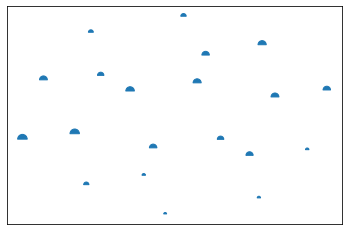

In [10]:
G=nx.dodecahedral_graph()
node_size=np.random.rand(len(G.nodes()))*100 
nodes=nx.draw_networkx_nodes(G,pos=nx.spring_layout(G),node_size = node_size,
                             node_shape=matplotlib.markers.MarkerStyle(marker='o', fillstyle='top'))

# Create 3 people lists

In [3]:
df_org=pd.read_excel('emails-combine 06162020.xlsx',sheet_name=0,usecols=[1,2,3,15,19,23])
gorvenment_people_list = []
for i in range(len(df_org)):
    row = df_org.iloc[i]
    if pd.isnull(row['First']):
        continue
    first = str(row['First']).lower().strip()
    last = str(row['Last']).lower().strip()
    if pd.isnull(row['Email']):
        email = first + '_' + last
    else:
        email = row['Email'].lower().strip()
    if row['Organization1'] is not np.nan:
        if 'Tallahassee' in row['Organization1'] or 'Leon County' in row['Organization1']:
            gorvenment_people_list.append( (first, last, email) )
            continue
    if row['Organization 2'] is not np.nan:
        if 'Tallahassee' in row['Organization 2'] or 'Leon County' in row['Organization 2']:
            gorvenment_people_list.append( (first, last, email) )
            continue
    if row['Organization 3'] is not np.nan:
        if 'Tallahassee' in row['Organization 3'] or 'Leon County' in row['Organization 3']:
            gorvenment_people_list.append( (first, last, email) )
            continue
print(len(gorvenment_people_list))

130


In [4]:
# directly copy from the notebook extracting CRA and Commissioner emails in stages
cra_list = [('john', 'dailey', 'john_dailey'),
            
            ('bryan', 'desloge', 'bryan@deslogemedical.com'),
            ('commissionerbryan', 'desloge', 'commissionerbryan_desloge'),
            ('bryan', 'desloge', 'desloge.bryan@gmail.com'),
            ('bryan', 'desloge', 'deslogeb@leoncountyfl.gov'),
            
            ('jessica', 'miller', 'jessica.miller@talgov.com'),
            
            ('jane', 'sauls', 'jane_sauls'),
            
            ('nick', 'maddox', 'maddox.nicholas@gmail.com'),
            ('nick', 'maddox', 'maddoxn@leoncountyfl.gov'),
            
            ('mary ann lindley', '', 'lindleym@leoncountyfl.gov'),
            ('maryann', 'lindley', 'maryann_lindley'),
            ('mary', 'lindley', 'mary_lindley'),
            
            ('kristin', '', 'kristindozier@gmail.com'),
            ('kristen', 'dozier', 'kristen_dozier'),
            ('kristin', 'dozer', 'kristin_dozer'),
            ('kristin', 'dozier', 'dozierk@leoncountyfl.gov'),
            
            ('bill', 'proctor', 'proctorb@leoncountyfl.gov')
           ]

commissioner_list = [('scoi', 'maddox', 'scoi.maddox@talgov.com'),
                     ('scott', 'maddox', 'maddox@maddoxhorne.com'),
                     ('scott', 'mattox', 'scott@govinc.net'),
                     ('scott', 'maddox', 'scottcharlesmaddox@gmail.com'),
                     ('scott', 'maddox', 'scott@scottmaddox.com'),
                     ('scott', 'maddox', 'shamaddox@embarqmail.com'),
                     ('scott', 'maddox', 'scott.maddox@talgov.com'),
                     ('scof', 'maddox', 'scof.maddox@talgov.com'),
                     ('scos', 'maddox', 'scos.maddox@talgov.com'),
                     ('sha', 'maddox', 'sha_maddox'),
                     
                     ('andrew', 'gillum', 'ademetricg@gmail.com'),
                     ('andrew', 'gillum', 'agillum@pfaw.org'),
                     ('commissionerandrew', 'gillum', 'commissionerandrew_gillum'),
                     ('andrew', 'gilliam', 'andrew_gilliam'),
                     ('andrew', 'gillium', 'andrew_gillium'),
                     ('andrew', 'gillum', 'andrew@andrewgillum.com'),
                     ('andrew', 'gillum', 'gilluma@talgov.com'),
                     ('andrew', 'gillum', 'andrew.gillum@talgov.com'),
                     ('andrew', 'gillams', 'andrew_gillams'),
                     
                     ('mark', 'mustian', 'mmustian@ngnlaw.com'),
                     ('f11332', 'l11332', 'mark@markmustian.com'),
                     ('f11334', 'l11334', 'mark@markmustian.com'),
                     ('mark', 'mustian', 'mmustian@ngn-tally.com'),
                     ('f11333', 'l11333', 'mark@markmustian.com'),
                     
                     ('gil', 'ziffer', 'gil@ziffberry.com'),
                     ('gil', 'ziffer', 'gil.ziffer@talgov.com'),
                     
                     ('curtis', 'richardsom', 'curtis_richardsom'),
                     ('curus', 'richardson', 'curus.richardson@talgov.com'),
                     ('ultis', 'richardson', 'ultis_richardson'),
                     ('curtis', 'richardson', 'cabaide@aol.com'),
                     
                     ('nancy', 'miller', 'jacqueline.hightower@famu.edu'),
                     ('nancy', 'miller', 'nancy.miller@talgov.com'),
                     
                     ('john', 'marks', 'john.marksiii@talgov.com'),
                     ('john', 'marks', 'john.marks@talgov.com')
                    ]
total_list = cra_list + commissioner_list

# read in emails

In [5]:
df_email = pd.read_csv('output7_new_sentiment.csv',index_col = 0)
from_list = df_email['From'].values.tolist()
for i in range(len(from_list)):
    from_list[i] = eval(from_list[i])
df_email['From'] = from_list

to_list = df_email['To'].values.tolist()
for i in range(len(to_list)):
    to_list[i] = eval(to_list[i])
df_email['To'] = to_list

cc_list = df_email['CC'].values.tolist()
for i in range(len(cc_list)):
    cc_list[i] = eval(cc_list[i])
df_email['CC'] = cc_list

df_email


,From,Sent,To,CC,Subject,Attachments,Importance,Body,textblob_sentiment,nltk_sentiment,flair_sentiment,GCP_sentiment
0,"(cindy, dick, cynthia.dick@talgov.com)",2011-08-18 12:12:00,"[(fire, department, fire_department)]",[],[],[],[],['I recently came across this quote and reflec...,"[0.275, 0.39583333333333337]","[0.0, 0.149, 0.701, 0.149]",POSITIVE (0.9575),"[0.30000001192092896, 1.7999999523162842, 0.02..."
1,"(mark, decarlo, mark.decarlo@talgov.com)",2011-08-20 03:44:00,"[(fire, department, fire_department)]",[],[],[],[],[''],"[0.0, 0.0]","[0.0, 0.0, 0.0, 0.0]",empty body,"[0.0, 0.0, 0.0]"
2,"(deborah, heiter, deborah.heiter@talgov.com)",2012-01-20 16:41:00,"[(bill, behenna, bill_behenna), (cathy, branch...",[],[],[],[],"['', 'Deborah L. Heiter', 'Administrative Spec...","[0.07253787878787879, 0.3424242424242424]","[0.9318, 0.0, 0.93, 0.07]",POSITIVE (0.8154),"[0.0, 2.799999952316284, 0.009523809361620015]"
3,"(beth, kirkland, bkirkland@taledc.com)",2012-01-23 09:32:00,"[(f496, l496, llaubscher@eflorida.com)]","[(f18020, l18020, brook.pace@deo.myflorida.com...",[],[],[],"['Louis,', 'Thank you for meeting with us in F...","[0.012500000000000011, 0.36944444444444446]","[0.9599, 0.021, 0.847, 0.132]",POSITIVE (0.9031),"[0.20000000298023224, 2.799999952316284, 0.010..."
4,"(vida, addison, vida.addison@talgov.com)",2012-02-07 15:19:00,"[(gary yordon' no, they have not told me anyth...",[],[],[],[],"['Hello, Do you have a 4meline for when a deci...","[0.021875000000000006, 0.403125]","[0.8708, 0.0, 0.879, 0.121]",NEGATIVE (0.9894),"[0.0, 0.6000000238418579, 0.0052631581038759465]"
...,...,...,...,...,...,...,...,...,...,...,...,...
21809,"(gina, fletcher, gfletcher@leonpa.org)",2017-09-26 11:12:00,"[(vince, long, longv@leoncountyfl.gov), (rick,...","[(f22301, l22301, rosss@leoncountyfl.gov), (f2...",[],[],"[""High Good morning, everyone! I have been c...",[],"[0.0, 0.0]","[0.0, 0.0, 0.0, 0.0]",empty body,"[0.0, 0.0, 0.0]"
21810,"(alison, faris, alison.faris@talgov.com)",2017-09-26 11:20:00,"[(suzanne, hughes, suzanneh@floridarealtors.org)]","[(paige, carter-smith, paige.tallahasseedownto...",[],[],[],"['', 'Thanks for leqng us know about your plan...","[0.2333333333333333, 0.4000000000000001]","[0.9001, 0.0, 0.842, 0.158]",POSITIVE (0.9654),"[0.10000000149011612, 2.200000047683716, 0.028..."
21811,"(suzanne, hughes, suzanneh@floridarealtors.org)",2017-09-26 13:41:00,"[(alison, faris, afaris@comcast.net)]","[(paige, carter-smith, paige.tallahasseedownto...",[],[],[],"['', '', 'Great! And yes, wed love to let eve...","[0.625, 0.5166666666666667]","[0.9421, 0.0, 0.377, 0.623]",POSITIVE (0.9982),"[0.800000011920929, 2.5999999046325684, 0.1529..."
21812,"(edward, kring, edward.kring@talgov.com)",2017-09-26 17:48:00,"[(suzanne, hughes, suzanneh@floridarealtors.or...","[(paige, carter-smith, paige.tallahasseedownto...",[],[],[],"['', 'HI Suzanne I hope this nds you well. Pl...","[-0.75, 1.0]","[0.891, 0.0, 0.741, 0.259]",POSITIVE (0.8982),"[0.10000000149011612, 0.800000011920929, 0.014..."


In [6]:
unique_people = set()
for i in range(len(from_list)):
    unique_people.add(from_list[i])

for i in range(len(cc_list)):
    for lst in cc_list[i]:
        unique_people.add(lst)

for i in range(len(to_list)):
    for lst in to_list[i]:
        unique_people.add(lst)
unique_people = list(unique_people)
unique_people.sort()
name2id, id2name = nameToIndexDict(unique_people)

len(unique_people)


38069

In [7]:
cra_idx_list = []
for i,people in enumerate(unique_people):
    if people in cra_list:
        cra_idx_list.append(i)
#         print(people)
len(cra_idx_list)

17

In [8]:
commissioner_idx_list = []
for i,people in enumerate(unique_people):
    if people in commissioner_list:
        commissioner_idx_list.append(i)
#         print(people)
len(commissioner_idx_list)

34

In [9]:
total_idx_list = cra_idx_list + commissioner_idx_list

In [10]:
government_idx_list = []
for i,people in enumerate(unique_people):
    for j,people2 in enumerate(gorvenment_people_list):
        if people[2] == people2[2] or (people[0] == people2[0] and people[1] == people2[1]):
            if i not in cra_idx_list and i not in commissioner_idx_list :
                government_idx_list.append(i)
                break
len(government_idx_list)

205

In [11]:
num_TO = []
num_TO = []
num_CC = []
num_TO_CC = []
for i in range(len(to_list)):
    num_TO.append(len(to_list[i]))
    num_CC.append(len(cc_list[i]))
    num_TO_CC.append(len(to_list[i]) + len(cc_list[i]))
df_email['num_TO'] = num_TO
df_email['num_CC'] = num_CC
df_email['num_TO_CC'] = num_TO_CC

In [12]:
# seperate emails by sent time
date_email = pd.to_datetime(df_email['Sent'])
idxt1 = date_email>datetime(2014,1,23)
idxt2 = date_email>datetime(2014,5,14)
idxt3 = date_email>datetime(2016,2,24)
idxe1 = np.array(idxt1==False)
idxe2 = np.array((idxt1==True) & (idxt2==False))
idxe3 = np.array((idxt2==True) & (idxt3==False))
idxe4 = np.array(idxt3==True)

idxes = [idxe1, idxe2, idxe3, idxe4]
stage_labels = ['before 2014,1,23', '2014,1,23 - 2014,5,14', '2014,5,14 - 2016,2,24', 'after 2016,2,24']

# plot all without switch

t1 0.11983704566955566
matrix done, time: 16.69159245491028
seperated people by position, time: 16.8149733543396
Done adding edges and nodes: 25.240715980529785
Done plotting: 43.247379541397095
t1 43.282259941101074
matrix done, time: 59.726749658584595
seperated people by position, time: 59.81767702102661
Done adding edges and nodes: 67.9591658115387
Done plotting: 85.72924375534058
t1 85.79571580886841
matrix done, time: 102.41624689102173
seperated people by position, time: 102.51058506965637
Done adding edges and nodes: 110.95779705047607
Done plotting: 128.58614134788513
t1 128.64812588691711
matrix done, time: 145.19678807258606
seperated people by position, time: 145.28847455978394
Done adding edges and nodes: 153.42198848724365


DEBUG:matplotlib.axes._base:top of axes not in the figure, so title not moved
DEBUG:matplotlib.axes._base:top of axes not in the figure, so title not moved
DEBUG:matplotlib.axes._base:top of axes not in the figure, so title not moved
DEBUG:matplotlib.axes._base:top of axes not in the figure, so title not moved
DEBUG:matplotlib.axes._base:top of axes not in the figure, so title not moved
DEBUG:matplotlib.axes._base:top of axes not in the figure, so title not moved


Done plotting: 170.81993865966797



DEBUG:matplotlib.axes._base:top of axes not in the figure, so title not moved
DEBUG:matplotlib.axes._base:top of axes not in the figure, so title not moved
DEBUG:matplotlib.axes._base:top of axes not in the figure, so title not moved
DEBUG:matplotlib.axes._base:top of axes not in the figure, so title not moved
DEBUG:matplotlib.axes._base:top of axes not in the figure, so title not moved
DEBUG:matplotlib.axes._base:top of axes not in the figure, so title not moved
DEBUG:matplotlib.axes._base:top of axes not in the figure, so title not moved
DEBUG:matplotlib.axes._base:top of axes not in the figure, so title not moved
DEBUG:matplotlib.axes._base:top of axes not in the figure, so title not moved
DEBUG:matplotlib.axes._base:top of axes not in the figure, so title not moved
DEBUG:matplotlib.axes._base:top of axes not in the figure, so title not moved
DEBUG:matplotlib.axes._base:top of axes not in the figure, so title not moved
DEBUG:matplotlib.axes._base:top of axes not in the figure, so ti

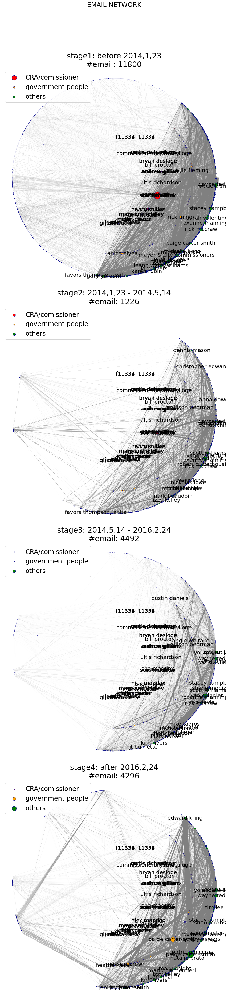

In [13]:
# 
fig = plt.figure(figsize=(12,50))
fig.suptitle('EMAIL NETWORK',fontsize = 24, y=1.04)
start_time = time.time()
# fig.text(.5, 1.005, 'edge thickness: #emails weighted by #receivers, then normalized $\in$(0,1)\n node size: #emails related', fontsize = 20, ha='center')
for k in trange(4):
    # build adjmat
    df_temp = df_email.iloc[idxes[k]]
    num_email = len(df_temp)
#     adj_email_mat1 = np.zeros((len(unique_people),len(unique_people)))
    adj_email_mat2 = np.zeros((len(unique_people),len(unique_people)))

    temp_from_list = df_temp['From'].values.tolist()
    temp_to_list = df_temp['To'].values.tolist()
    temp_cc_list = df_temp['CC'].values.tolist()
    num_TO_CC = df_temp['num_TO_CC'].values.tolist()

    for i in range(len(temp_from_list)):
        s = name2id[temp_from_list[i]] # id of the sender
        
        rs = temp_to_list[i]
        for j in range(len(rs)):
            if rs[j] != ('', '', '') and rs[j] != ['', '', '']:
                r = name2id[rs[j]]  # id of the receiver
#                 adj_email_mat1[s,r] += 1
                adj_email_mat2[s,r] += 1/num_TO_CC[i]
        cs = temp_cc_list[i]
        for j in range(len(cs)):
            if cs[j] != ('', '', '') and cs[j] != ['', '', '']:
                r = name2id[cs[j]]  # id of the receiver
#                 adj_email_mat1[s,r] += 1
                adj_email_mat2[s,r] += 1/num_TO_CC[i]
    print('t1', time.time()-start_time)
    
#     adj_email_mat1 = adj_email_mat1 + adj_email_mat1.T
    adj_email_mat2 = adj_email_mat2 + adj_email_mat2.T
    
#     adj_email_mat1 = np.triu(adj_email_mat1, 1)
    adj_email_mat2 = np.triu(adj_email_mat2, 1)
        
    adj_email_mat2 = adj_email_mat2/adj_email_mat2.max()
    
    print('matrix done, time:', time.time()-start_time)
#     adj_mat = adj_email_mat2
        
    plt.subplot(4,1,k+1)
    nodes = unique_people

    G = nx.Graph()
#     G.add_nodes_from(nodes)
    networks = [1,2,3]

    networks_list = []
    for i in range(len(unique_people)):
        if i in total_idx_list:
            networks_list.append(1)
        elif i in government_idx_list:
            networks_list.append(2)
        else:
            networks_list.append(3)
    print('seperated people by position, time:', time.time()-start_time)
        
    # map color
    node_network_map = dict(zip(nodes, networks_list))
    colors = ['red', 'orange', 'green']
    color_map = dict(zip(networks, colors))

#     mat = adj_email_mat2 # selecting the matrix use for plot
    
    # build graph from numpy array 
    G = nx.from_numpy_array(adj_email_mat2, create_using=nx.Graph)
    G = nx.relabel_nodes(G, id2name)   # relabel the node with corresponding names

    nodes_by_color = {val: [node for node in G if color_map[node_network_map[node]] == val]
                      for val in colors}
    print('Done adding edges and nodes:', time.time()-start_time)
    
    pos = nx.circular_layout(G) # calculate position
    radii = [6,10,13]  # set the diameter for the three circles

    for ea in pos.keys():
        new_r = 1
        if ea in nodes_by_color['red']:
            new_r = radii[0]
        elif ea in nodes_by_color['orange']:
            new_r = radii[1]
        elif ea in nodes_by_color['green']:
            new_r = radii[2]
        else:
            pass
        pos[ea] *= new_r   # reposition nodes as concentric circles
    
    # calculate edge width
    edge_width = []
    edges_list = G.edges()
    for s,t in edges_list:
        edge_width.append(adj_email_mat2[name2id[s],name2id[t]])
    edge_width = np.array(edge_width)
    edge_width = 20*edge_width
    
    # calculate node size
    node_size = adj_email_mat2.sum(axis=0)
    node_size = 100*node_size
    
    # select several most active people and label their names
    labeling_idx = node_size.argsort()[-25:][::-1]
    labels = {}
    for i in labeling_idx:
        node = id2name[i]
        labels[node] = node[0] + ' ' + node[1]
    for node,group in node_network_map.items():
        if group == 1:
            labels[node] = node[0] + ' ' + node[1]

    node_sizes = {}
    node_sizes['red'] = node_size[total_idx_list]
    node_sizes['orange'] = node_size[government_idx_list]
    node_sizes['green'] = node_size[[item for item in np.arange(len(unique_people)) if item not in (total_idx_list+government_idx_list)]]

    
    legend_labels = {'red': 'CRA/comissioner','orange': 'government people','green': 'others' }
    for color, node_names in nodes_by_color.items():
        local_node_size = node_sizes[color]
        nx.draw_networkx_nodes(G, pos=pos, node_size=local_node_size, edgecolors='darkblue', nodelist=node_names, node_color=color, label=legend_labels[color])

    nx.draw_networkx_edges(G, pos=pos, width=edge_width, edge_color = 'grey')
    nx.draw_networkx_labels(G, pos=pos, labels=labels, font_size=20, font_color='black')
    plt.title('stage'+str(k+1)+': '+stage_labels[k] + '\n#email: '+str(num_email),fontsize = 28)
    plt.legend(fontsize = 24, loc=2)
    plt.axis('off')
    print('Done plotting:', time.time()-start_time)
    
    # free memory, otherwise it will crash because of unsuffient memory
    adj_email_mat2 = None
    
plt.tight_layout()
# plt.savefig('Email_network3.png')
plt.show()


# plot all with switch

In [14]:
# switch index, so that people in the center circle can be evenly distributed on the circle
new_idx = np.linspace(0,len(unique_people),len(total_idx_list)+1, dtype = int)[:-1]
for i in range(len(total_idx_list)):
    p1_idx = total_idx_list[i]
    p1 = unique_people[p1_idx]
    p2_idx = new_idx[i]
    p2 = unique_people[p2_idx]
    unique_people[p1_idx], unique_people[p2_idx] = p2, p1
    
    if p2_idx in government_idx_list:
        total_idx_list[i], government_idx_list[government_idx_list.index(p2_idx)] = p2_idx, p1_idx
    else:
        total_idx_list[i] = p2_idx
name2id, id2name = nameToIndexDict(unique_people)

cra_idx_list = total_idx_list[:len(cra_idx_list)]
commissioner_idx_list = total_idx_list[len(cra_idx_list):]
#     print(p1,p2)

t1 0.11669731140136719
matrix done, time: 16.588810205459595
seperated people by position, time: 16.958430528640747
Done adding edges and nodes: 25.123700380325317
Done plotting: 42.4821982383728
t1 42.51680254936218
matrix done, time: 58.944249868392944
seperated people by position, time: 59.29336142539978
Done adding edges and nodes: 67.55503129959106
Done plotting: 84.80426788330078
t1 84.86835145950317
matrix done, time: 101.42085433006287
seperated people by position, time: 101.79065561294556
Done adding edges and nodes: 110.0266466140747
Done plotting: 127.81463027000427
t1 127.87422847747803
matrix done, time: 144.37071681022644
seperated people by position, time: 144.7527322769165
Done adding edges and nodes: 153.0086681842804


DEBUG:matplotlib.axes._base:top of axes not in the figure, so title not moved
DEBUG:matplotlib.axes._base:top of axes not in the figure, so title not moved
DEBUG:matplotlib.axes._base:top of axes not in the figure, so title not moved
DEBUG:matplotlib.axes._base:top of axes not in the figure, so title not moved
DEBUG:matplotlib.axes._base:top of axes not in the figure, so title not moved
DEBUG:matplotlib.axes._base:top of axes not in the figure, so title not moved


Done plotting: 170.68903970718384



DEBUG:matplotlib.axes._base:top of axes not in the figure, so title not moved
DEBUG:matplotlib.axes._base:top of axes not in the figure, so title not moved
DEBUG:matplotlib.axes._base:top of axes not in the figure, so title not moved
DEBUG:matplotlib.axes._base:top of axes not in the figure, so title not moved
DEBUG:matplotlib.axes._base:top of axes not in the figure, so title not moved
DEBUG:matplotlib.axes._base:top of axes not in the figure, so title not moved
DEBUG:matplotlib.axes._base:top of axes not in the figure, so title not moved
DEBUG:matplotlib.axes._base:top of axes not in the figure, so title not moved
DEBUG:matplotlib.axes._base:top of axes not in the figure, so title not moved
DEBUG:matplotlib.axes._base:top of axes not in the figure, so title not moved
DEBUG:matplotlib.axes._base:top of axes not in the figure, so title not moved
DEBUG:matplotlib.axes._base:top of axes not in the figure, so title not moved
DEBUG:matplotlib.axes._base:top of axes not in the figure, so ti

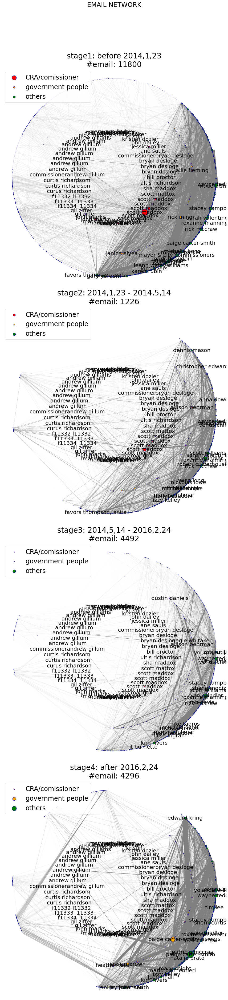

In [15]:
# 
fig = plt.figure(figsize=(12,50))
fig.suptitle('EMAIL NETWORK',fontsize = 24, y=1.04)
start_time = time.time()
# fig.text(.5, 1.005, 'edge thickness: #emails weighted by #receivers, then normalized $\in$(0,1)\n node size: #emails related', fontsize = 20, ha='center')
for k in trange(4):
    # build adjmat
    df_temp = df_email.iloc[idxes[k]]
    num_email = len(df_temp)
#     adj_email_mat1 = np.zeros((len(unique_people),len(unique_people)))
    adj_email_mat2 = np.zeros((len(unique_people),len(unique_people)))

    temp_from_list = df_temp['From'].values.tolist()
    temp_to_list = df_temp['To'].values.tolist()
    temp_cc_list = df_temp['CC'].values.tolist()
    num_TO_CC = df_temp['num_TO_CC'].values.tolist()

    for i in range(len(temp_from_list)):
        s = name2id[temp_from_list[i]] # id of the sender
        
        rs = temp_to_list[i]
        for j in range(len(rs)):
            if rs[j] != ('', '', '') and rs[j] != ['', '', '']:
                r = name2id[rs[j]]  # id of the receiver
#                 adj_email_mat1[s,r] += 1
                adj_email_mat2[s,r] += 1/num_TO_CC[i]
        cs = temp_cc_list[i]
        for j in range(len(cs)):
            if cs[j] != ('', '', '') and cs[j] != ['', '', '']:
                r = name2id[cs[j]]  # id of the receiver
#                 adj_email_mat1[s,r] += 1
                adj_email_mat2[s,r] += 1/num_TO_CC[i]
    print('t1', time.time()-start_time)
    
#     adj_email_mat1 = adj_email_mat1 + adj_email_mat1.T
    adj_email_mat2 = adj_email_mat2 + adj_email_mat2.T
    
#     adj_email_mat1 = np.triu(adj_email_mat1, 1)
    adj_email_mat2 = np.triu(adj_email_mat2, 1)
        
    adj_email_mat2 = adj_email_mat2/adj_email_mat2.max()
    
    print('matrix done, time:', time.time()-start_time)
#     adj_mat = adj_email_mat2
        
    plt.subplot(4,1,k+1)
    nodes = unique_people

    G = nx.Graph()
#     G.add_nodes_from(nodes)
    networks = [1,2,3]

    networks_list = []
    for i in range(len(unique_people)):
        if i in total_idx_list:
            networks_list.append(1)
        elif i in government_idx_list:
            networks_list.append(2)
        else:
            networks_list.append(3)
    print('seperated people by position, time:', time.time()-start_time)
        
    # map color
    node_network_map = dict(zip(nodes, networks_list))
    colors = ['red', 'orange', 'green']
    color_map = dict(zip(networks, colors))

#     mat = adj_email_mat2 # selecting the matrix use for plot
    
    # build graph from numpy array 
    G = nx.from_numpy_array(adj_email_mat2, create_using=nx.Graph)
    G = nx.relabel_nodes(G, id2name)   # relabel the node with corresponding names

    nodes_by_color = {val: [node for node in G if color_map[node_network_map[node]] == val]
                      for val in colors}
    print('Done adding edges and nodes:', time.time()-start_time)
    
    pos = nx.circular_layout(G) # calculate position
    radii = [6,10,13]  # set the diameter for the three circles

    for ea in pos.keys():
        new_r = 1
        if ea in nodes_by_color['red']:
            new_r = radii[0]
        elif ea in nodes_by_color['orange']:
            new_r = radii[1]
        elif ea in nodes_by_color['green']:
            new_r = radii[2]
        else:
            pass
        pos[ea] *= new_r   # reposition nodes as concentric circles
    
    # calculate edge width
    edge_width = []
    edges_list = G.edges()
    for s,t in edges_list:
        edge_width.append(adj_email_mat2[name2id[s],name2id[t]])
    edge_width = np.array(edge_width)
    edge_width = 20*edge_width
    
    # calculate node size
    node_size = adj_email_mat2.sum(axis=0)
    node_size = 100*node_size
    
    # select several most active people and label their names
    labeling_idx = node_size.argsort()[-25:][::-1]
    labels = {}
    for i in labeling_idx:
        node = id2name[i]
        labels[node] = node[0] + ' ' + node[1]
    for node,group in node_network_map.items():
        if group == 1:
            labels[node] = node[0] + ' ' + node[1]

    node_sizes = {}
    node_sizes['red'] = node_size[total_idx_list]
    node_sizes['orange'] = node_size[government_idx_list]
    node_sizes['green'] = node_size[[item for item in np.arange(len(unique_people)) if item not in (total_idx_list+government_idx_list)]]

    
    legend_labels = {'red': 'CRA/comissioner','orange': 'government people','green': 'others' }
    for color, node_names in nodes_by_color.items():
        local_node_size = node_sizes[color]
        nx.draw_networkx_nodes(G, pos=pos, node_size=local_node_size, edgecolors='darkblue', nodelist=node_names, node_color=color, label=legend_labels[color])

    nx.draw_networkx_edges(G, pos=pos, width=edge_width, edge_color = 'grey')
    nx.draw_networkx_labels(G, pos=pos, labels=labels, font_size=20, font_color='black')
    plt.title('stage'+str(k+1)+': '+stage_labels[k] + '\n#email: '+str(num_email),fontsize = 28)
    plt.legend(fontsize = 24, loc=2)
    plt.axis('off')
    print('Done plotting:', time.time()-start_time)
    
    # free memory, otherwise it will crash because of unsuffient memory
    adj_email_mat2 = None
    
plt.tight_layout()
# plt.savefig('Email_network3.png')
plt.show()


# extract CRA and commissioner related emails

In [16]:
# find all CRA and commissioner related emails
keep_idx=[]
for i in range(len(from_list)):
    for j in range(len(total_list)):
        if total_list[j] == from_list[i] :
            keep_idx.append(i)
            break
        for t in to_list[i]:
            if total_list[j] == t:
                keep_idx.append(i)
                break
        for cc in cc_list[i]:
            if total_list[j] == cc:
                keep_idx.append(i)
                break
len(keep_idx)

8623

In [17]:
df_related_emails = df_email.iloc[keep_idx]
df_related_emails = df_related_emails.reset_index(drop=True)
df_related_emails

,From,Sent,To,CC,Subject,Attachments,Importance,Body,textblob_sentiment,nltk_sentiment,flair_sentiment,GCP_sentiment,num_TO,num_CC,num_TO_CC
0,"(deborah, heiter, deborah.heiter@talgov.com)",2012-01-20 16:41:00,"[(bill, behenna, bill_behenna), (cathy, branch...",[],[],[],[],"['', 'Deborah L. Heiter', 'Administrative Spec...","[0.07253787878787879, 0.3424242424242424]","[0.9318, 0.0, 0.93, 0.07]",POSITIVE (0.8154),"[0.0, 2.799999952316284, 0.009523809361620015]",31,0,31
1,"(deborah, heiter, deborah.heiter@talgov.com)",2012-01-20 16:41:00,"[(bill, behenna, bill_behenna), (cathy, branch...",[],[],[],[],"['', 'Deborah L. Heiter', 'Administrative Spec...","[0.07253787878787879, 0.3424242424242424]","[0.9318, 0.0, 0.93, 0.07]",POSITIVE (0.8154),"[0.0, 2.799999952316284, 0.009523809361620015]",31,0,31
2,"(diana, oropallo, doropallo@comcast.net)",2012-04-02 22:07:00,"[(sheila, costigan, costigans@leonschools.net)...","[("", "", , "", ""_ )]",[],[],[],"['Just to piggy back on Sheilas email, your at...","[0.18214285714285716, 0.4107142857142857]","[0.9778, 0.0, 0.818, 0.182]",POSITIVE (0.8923),"[0.4000000059604645, 4.5, 0.02601156069364162]",63,1,64
3,"(diana, oropallo, doropallo@comcast.net)",2012-04-02 22:07:00,"[(sheila, costigan, costigans@leonschools.net)...","[("", "", , "", ""_ )]",[],[],[],"['Just to piggy back on Sheilas email, your at...","[0.18214285714285716, 0.4107142857142857]","[0.9778, 0.0, 0.818, 0.182]",POSITIVE (0.8923),"[0.4000000059604645, 4.5, 0.02601156069364162]",63,1,64
4,"(sheila, costigan, costigans@leonschools.net)",2012-04-04 14:12:00,"[(leslie, smith, lesliehsmith@gmail.com), (adm...",[],['March Executive Director Report'],['FLCS.EX.DIR.report.March.2012.docx; STOMP.CO...,[],"['REPORT.docx', 'Dear BOD, please find attache...","[0.16754086727666279, 0.40936088154269956]","[0.9993, 0.005, 0.827, 0.168]",POSITIVE (0.9924),"[0.20000000298023224, 17.299999237060547, 0.01...",29,0,29
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
8618,"(edward, holifield, ewholifield@yahoo.com)",2017-09-07 00:45:00,"[(paul, lamaster, paullamaster250@comcast.net)...",[],[],[],[],"['', 'And all for the entertainment of the pow...","[0.2571794871794872, 0.49282051282051287]","[0.8795, 0.023, 0.863, 0.115]",POSITIVE (0.9932),"[0.10000000149011612, 6.400000095367432, 0.041...",58,0,58
8619,"(edward, holifield, ewholifield@yahoo.com)",2017-09-07 00:45:00,"[(paul, lamaster, paullamaster250@comcast.net)...",[],[],[],[],"['', 'And all for the entertainment of the pow...","[0.2571794871794872, 0.49282051282051287]","[0.8795, 0.023, 0.863, 0.115]",POSITIVE (0.9932),"[0.10000000149011612, 6.400000095367432, 0.041...",58,0,58
8620,"(edward, holifield, ewholifield@yahoo.com)",2017-09-07 00:45:00,"[(paul, lamaster, paullamaster250@comcast.net)...",[],[],[],[],"['', 'And all for the entertainment of the pow...","[0.2571794871794872, 0.49282051282051287]","[0.8795, 0.023, 0.863, 0.115]",POSITIVE (0.9932),"[0.10000000149011612, 6.400000095367432, 0.041...",58,0,58
8621,"(edward, holifield, ewholifield@yahoo.com)",2017-09-07 00:45:00,"[(paul, lamaster, paullamaster250@comcast.net)...",[],[],[],[],"['', 'And all for the entertainment of the pow...","[0.2571794871794872, 0.49282051282051287]","[0.8795, 0.023, 0.863, 0.115]",POSITIVE (0.9932),"[0.10000000149011612, 6.400000095367432, 0.041...",58,0,58


# update 3 people list

In [18]:
from_list = df_related_emails['From'].values.tolist()
to_list = df_related_emails['To'].values.tolist()
cc_list = df_related_emails['CC'].values.tolist()


from_list = standardize_triplet(from_list)
to_list = standardize_triplet(to_list)
cc_list = standardize_triplet(cc_list)

In [19]:
num_TO = []
num_TO = []
num_CC = []
num_TO_CC = []
for i in range(len(to_list)):
    num_TO.append(len(to_list[i]))
    num_CC.append(len(cc_list[i]))
    num_TO_CC.append(len(to_list[i]) + len(cc_list[i]))
df_related_emails['num_TO'] = num_TO
df_related_emails['num_CC'] = num_CC
df_related_emails['num_TO_CC'] = num_TO_CC

In [20]:
unique_people = set()
for i in range(len(from_list)):
    unique_people.add(from_list[i])

for i in range(len(cc_list)):
    for lst in cc_list[i]:
        unique_people.add(lst)

for i in range(len(to_list)):
    for lst in to_list[i]:
        unique_people.add(lst)
unique_people = list(unique_people)
unique_people.sort()
name2id, id2name = nameToIndexDict(unique_people)

len(unique_people)


22775

In [21]:
cra_idx_list = []
for i,people in enumerate(unique_people):
    if people in cra_list:
        cra_idx_list.append(i)
#         print(people)
len(cra_idx_list)

17

In [22]:
commissioner_idx_list = []
for i,people in enumerate(unique_people):
    if people in commissioner_list:
        commissioner_idx_list.append(i)
#         print(people)
len(commissioner_idx_list)

34

In [23]:
total_idx_list = cra_idx_list + commissioner_idx_list

In [24]:
government_idx_list = []
for i,people in enumerate(unique_people):
    for j,people2 in enumerate(gorvenment_people_list):
        if people[2] == people2[2] or (people[0] == people2[0] and people[1] == people2[1]):
            if i not in cra_idx_list and i not in commissioner_idx_list :
                government_idx_list.append(i)
                break
len(government_idx_list)

135

In [25]:
# seperate emails by sent time
date_email = pd.to_datetime(df_related_emails['Sent'])
idxt1 = date_email>datetime(2014,1,23)
idxt2 = date_email>datetime(2014,5,14)
idxt3 = date_email>datetime(2016,2,24)
idxe1 = np.array(idxt1==False)
idxe2 = np.array((idxt1==True) & (idxt2==False))
idxe3 = np.array((idxt2==True) & (idxt3==False))
idxe4 = np.array(idxt3==True)

idxes = [idxe1, idxe2, idxe3, idxe4]
stage_labels = ['before 2014,1,23', '2014,1,23 - 2014,5,14', '2014,5,14 - 2016,2,24', 'after 2016,2,24']

# plot related without switch

t1 0.21284723281860352
matrix done, time: 11.02586579322815
seperated people by position, time: 11.070874691009521
Done adding edges and nodes: 14.090462923049927
Done plotting: 20.21109652519226
t1 20.259827136993408
matrix done, time: 30.870371341705322
seperated people by position, time: 30.921881675720215
Done adding edges and nodes: 33.86862087249756
Done plotting: 39.80875253677368
t1 39.90806579589844
matrix done, time: 50.5259313583374
seperated people by position, time: 50.577247619628906
Done adding edges and nodes: 53.60471844673157
Done plotting: 59.733553409576416
t1 59.784847259521484
matrix done, time: 70.38806176185608
seperated people by position, time: 70.43926644325256
Done adding edges and nodes: 73.36398029327393


DEBUG:matplotlib.axes._base:top of axes not in the figure, so title not moved
DEBUG:matplotlib.axes._base:top of axes not in the figure, so title not moved
DEBUG:matplotlib.axes._base:top of axes not in the figure, so title not moved
DEBUG:matplotlib.axes._base:top of axes not in the figure, so title not moved
DEBUG:matplotlib.axes._base:top of axes not in the figure, so title not moved
DEBUG:matplotlib.axes._base:top of axes not in the figure, so title not moved
DEBUG:matplotlib.axes._base:top of axes not in the figure, so title not moved
DEBUG:matplotlib.axes._base:top of axes not in the figure, so title not moved


Done plotting: 79.39715027809143



DEBUG:matplotlib.axes._base:top of axes not in the figure, so title not moved
DEBUG:matplotlib.axes._base:top of axes not in the figure, so title not moved
DEBUG:matplotlib.axes._base:top of axes not in the figure, so title not moved
DEBUG:matplotlib.axes._base:top of axes not in the figure, so title not moved
DEBUG:matplotlib.axes._base:top of axes not in the figure, so title not moved
DEBUG:matplotlib.axes._base:top of axes not in the figure, so title not moved
DEBUG:matplotlib.axes._base:top of axes not in the figure, so title not moved
DEBUG:matplotlib.axes._base:top of axes not in the figure, so title not moved
DEBUG:matplotlib.axes._base:top of axes not in the figure, so title not moved
DEBUG:matplotlib.axes._base:top of axes not in the figure, so title not moved
DEBUG:matplotlib.axes._base:top of axes not in the figure, so title not moved
DEBUG:matplotlib.axes._base:top of axes not in the figure, so title not moved


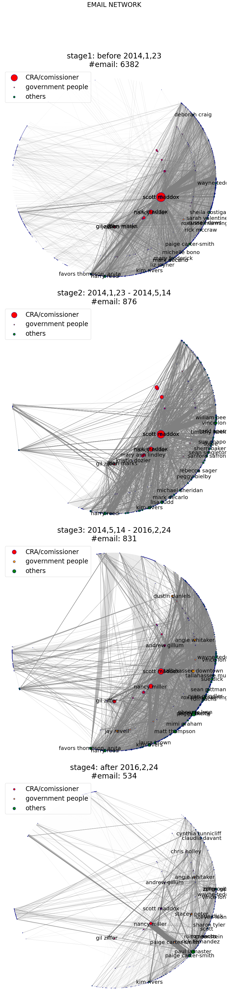

In [26]:
# 
fig = plt.figure(figsize=(12,50))
fig.suptitle('EMAIL NETWORK',fontsize = 24, y=1.04)
start_time = time.time()
# fig.text(.5, 1.005, 'edge thickness: #emails weighted by #receivers, then normalized $\in$(0,1)\n node size: #emails related', fontsize = 20, ha='center')
for k in trange(4):
    # build adjmat
    df_temp = df_related_emails.iloc[idxes[k]]
    num_email = len(df_temp)
    adj_email_mat1 = np.zeros((len(unique_people),len(unique_people)))
    adj_email_mat2 = np.zeros((len(unique_people),len(unique_people)))

    temp_from_list = df_temp['From'].values.tolist()
    temp_to_list = df_temp['To'].values.tolist()
    temp_cc_list = df_temp['CC'].values.tolist()
    num_TO_CC = df_temp['num_TO_CC'].values.tolist()

    for i in range(len(temp_from_list)):
        s = name2id[temp_from_list[i]] # id of the sender
        
        rs = temp_to_list[i]
        for j in range(len(rs)):
            if rs[j] != ('', '', '') and rs[j] != ['', '', '']:
                r = name2id[rs[j]]  # id of the receiver
                adj_email_mat1[s,r] += 1
                adj_email_mat2[s,r] += 1/num_TO_CC[i]
        cs = temp_cc_list[i]
        for j in range(len(cs)):
            if cs[j] != ('', '', '') and cs[j] != ['', '', '']:
                r = name2id[cs[j]]  # id of the receiver
                adj_email_mat1[s,r] += 1
                adj_email_mat2[s,r] += 1/num_TO_CC[i]
    print('t1', time.time()-start_time)
    
    adj_email_mat1 = adj_email_mat1 + adj_email_mat1.T
    adj_email_mat2 = adj_email_mat2 + adj_email_mat2.T
    
    adj_email_mat1 = np.triu(adj_email_mat1, 1)
    adj_email_mat2 = np.triu(adj_email_mat2, 1)
        
    adj_email_mat2 = adj_email_mat2/adj_email_mat2.max()
    
    print('matrix done, time:', time.time()-start_time)
    
    mat = adj_email_mat2 # selecting the matrix use for plot
        
    plt.subplot(4,1,k+1)
    nodes = unique_people

    G = nx.Graph()
#     G.add_nodes_from(nodes)
    networks = [1,2,3]

    networks_list = []
    for i in range(len(unique_people)):
        if i in total_idx_list:
            networks_list.append(1)
        elif i in government_idx_list:
            networks_list.append(2)
        else:
            networks_list.append(3)
    print('seperated people by position, time:', time.time()-start_time)
        
    # map color
    node_network_map = dict(zip(nodes, networks_list))
    colors = ['red', 'orange', 'green']
    color_map = dict(zip(networks, colors))

    
    # build graph from numpy array 
    G = nx.from_numpy_array(mat, create_using=nx.Graph)
    G = nx.relabel_nodes(G, id2name)   # relabel the node with corresponding names

    nodes_by_color = {val: [node for node in G if color_map[node_network_map[node]] == val]
                      for val in colors}
    print('Done adding edges and nodes:', time.time()-start_time)
    
    pos = nx.circular_layout(G) # calculate position
    radii = [5,8,10]  # set the diameter for the three circles

    for ea in pos.keys():
        new_r = 1
        if ea in nodes_by_color['red']:
            new_r = radii[0]
        elif ea in nodes_by_color['orange']:
            new_r = radii[1]
        elif ea in nodes_by_color['green']:
            new_r = radii[2]
        else:
            pass
        pos[ea] *= new_r   # reposition nodes as concentric circles
    
    # calculate edge width
    edge_width = []
    edges_list = G.edges()
    for s,t in edges_list:
        edge_width.append(mat[name2id[s],name2id[t]])
    edge_width = np.array(edge_width)
    edge_width = 20*edge_width
    
    # calculate node size
    node_size = mat.sum(axis=0)
    node_size = 100*node_size
    
    # select several most active people and label their names
    labeling_idx = node_size.argsort()[-25:][::-1]
    labels = {}
    for i in labeling_idx:
        node = id2name[i]
        labels[node] = node[0] + ' ' + node[1]
#     for node,group in node_network_map.items():
#         if group == 1:
#             labels[node] = node[0] + ' ' + node[1]

    node_sizes = {}
    node_sizes['red'] = node_size[total_idx_list]
    node_sizes['orange'] = node_size[government_idx_list]
    node_sizes['green'] = node_size[[item for item in np.arange(len(unique_people)) if item not in (total_idx_list+government_idx_list)]]

    
    legend_labels = {'red': 'CRA/comissioner','orange': 'government people','green': 'others' }
    for color, node_names in nodes_by_color.items():
        local_node_size = node_sizes[color]
        nx.draw_networkx_nodes(G, pos=pos, node_size=local_node_size, edgecolors='darkblue', nodelist=node_names, node_color=color, label=legend_labels[color])

    nx.draw_networkx_edges(G, pos=pos, width=edge_width, edge_color = 'grey')
    nx.draw_networkx_labels(G, pos=pos, labels=labels, font_size=20, font_color='black')
    plt.title('stage'+str(k+1)+': '+stage_labels[k] + '\n#email: '+str(num_email),fontsize = 28)
    plt.legend(fontsize = 24, loc=2)
    plt.axis('off')
    print('Done plotting:', time.time()-start_time)
    
plt.tight_layout()
# plt.savefig('Email_network3.png')
plt.show()


# plot related with switch

In [27]:
# switch index, so that people in the center circle can be evenly distributed on the circle
new_idx = np.linspace(0,len(unique_people),len(total_idx_list)+1, dtype = int)[:-1]
for i in range(len(total_idx_list)):
    p1_idx = total_idx_list[i]
    p1 = unique_people[p1_idx]
    p2_idx = new_idx[i]
    p2 = unique_people[p2_idx]
    unique_people[p1_idx], unique_people[p2_idx] = p2, p1
    
    if p2_idx in government_idx_list:
        total_idx_list[i], government_idx_list[government_idx_list.index(p2_idx)] = p2_idx, p1_idx
    else:
        total_idx_list[i] = p2_idx

name2id, id2name = nameToIndexDict(unique_people)

cra_idx_list = total_idx_list[:len(cra_idx_list)]
commissioner_idx_list = total_idx_list[len(cra_idx_list):]

t1 0.2144179344177246
matrix done, time: 10.856752157211304
seperated people by position, time: 11.0771324634552
Done adding edges and nodes: 14.177635431289673
Done plotting: 20.166215896606445
t1 20.21392250061035
matrix done, time: 30.81947374343872
seperated people by position, time: 31.03831720352173
Done adding edges and nodes: 33.98086190223694
Done plotting: 39.837533473968506
t1 39.94063997268677
matrix done, time: 50.56553268432617
seperated people by position, time: 50.77620458602905
Done adding edges and nodes: 53.782193183898926
Done plotting: 59.68161964416504
t1 59.7379047870636
matrix done, time: 70.32155442237854
seperated people by position, time: 70.53118634223938
Done adding edges and nodes: 73.60349774360657


DEBUG:matplotlib.axes._base:top of axes not in the figure, so title not moved
DEBUG:matplotlib.axes._base:top of axes not in the figure, so title not moved
DEBUG:matplotlib.axes._base:top of axes not in the figure, so title not moved
DEBUG:matplotlib.axes._base:top of axes not in the figure, so title not moved
DEBUG:matplotlib.axes._base:top of axes not in the figure, so title not moved
DEBUG:matplotlib.axes._base:top of axes not in the figure, so title not moved
DEBUG:matplotlib.axes._base:top of axes not in the figure, so title not moved
DEBUG:matplotlib.axes._base:top of axes not in the figure, so title not moved
DEBUG:matplotlib.axes._base:top of axes not in the figure, so title not moved
DEBUG:matplotlib.axes._base:top of axes not in the figure, so title not moved
DEBUG:matplotlib.axes._base:top of axes not in the figure, so title not moved
DEBUG:matplotlib.axes._base:top of axes not in the figure, so title not moved


Done plotting: 79.49196147918701



DEBUG:matplotlib.axes._base:top of axes not in the figure, so title not moved
DEBUG:matplotlib.axes._base:top of axes not in the figure, so title not moved
DEBUG:matplotlib.axes._base:top of axes not in the figure, so title not moved
DEBUG:matplotlib.axes._base:top of axes not in the figure, so title not moved
DEBUG:matplotlib.axes._base:top of axes not in the figure, so title not moved
DEBUG:matplotlib.axes._base:top of axes not in the figure, so title not moved
DEBUG:matplotlib.axes._base:top of axes not in the figure, so title not moved
DEBUG:matplotlib.axes._base:top of axes not in the figure, so title not moved


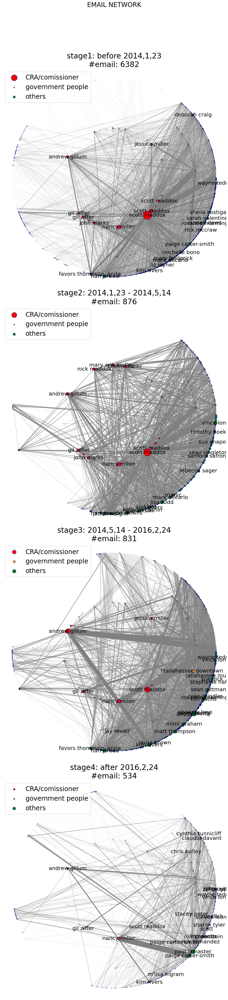

In [28]:
# 
fig = plt.figure(figsize=(12,50))
fig.suptitle('EMAIL NETWORK',fontsize = 24, y=1.04)
start_time = time.time()
# fig.text(.5, 1.005, 'edge thickness: #emails weighted by #receivers, then normalized $\in$(0,1)\n node size: #emails related', fontsize = 20, ha='center')
for k in trange(4):
    # build adjmat
    df_temp = df_related_emails.iloc[idxes[k]]
    num_email = len(df_temp)
    adj_email_mat1 = np.zeros((len(unique_people),len(unique_people)))
    adj_email_mat2 = np.zeros((len(unique_people),len(unique_people)))

    from_list = df_temp['From'].values.tolist()
    to_list = df_temp['To'].values.tolist()
    cc_list = df_temp['CC'].values.tolist()
    num_TO_CC = df_temp['num_TO_CC'].values.tolist()

    for i in range(len(from_list)):
        s = name2id[from_list[i]] # id of the sender
        
        rs = to_list[i]
        for j in range(len(rs)):
            if rs[j] != ('', '', '') and rs[j] != ['', '', '']:
                r = name2id[rs[j]]  # id of the receiver
                adj_email_mat1[s,r] += 1
                adj_email_mat2[s,r] += 1/num_TO_CC[i]
        cs = cc_list[i]
        for j in range(len(cs)):
            if cs[j] != ('', '', '') and cs[j] != ['', '', '']:
                r = name2id[cs[j]]  # id of the receiver
                adj_email_mat1[s,r] += 1
                adj_email_mat2[s,r] += 1/num_TO_CC[i]
    print('t1', time.time()-start_time)
    
    adj_email_mat1 = adj_email_mat1 + adj_email_mat1.T
    adj_email_mat2 = adj_email_mat2 + adj_email_mat2.T
    
    adj_email_mat1 = np.triu(adj_email_mat1, 1)
    adj_email_mat2 = np.triu(adj_email_mat2, 1)
        
    adj_email_mat2 = adj_email_mat2/adj_email_mat2.max()
    
    print('matrix done, time:', time.time()-start_time)
    adj_mat = adj_email_mat2
        
    plt.subplot(4,1,k+1)
    nodes = unique_people

    G = nx.Graph()
#     G.add_nodes_from(nodes)
    networks = [1,2,3]

    networks_list = []
    for i in range(len(unique_people)):
        if i in total_idx_list:
            networks_list.append(1)
        elif i in government_idx_list:
            networks_list.append(2)
        else:
            networks_list.append(3)
    print('seperated people by position, time:', time.time()-start_time)
        
    # map color
    node_network_map = dict(zip(nodes, networks_list))
    colors = ['red', 'orange', 'green']
    color_map = dict(zip(networks, colors))

    mat = adj_email_mat2 # selecting the matrix use for plot
    
    # build graph from numpy array 
    G = nx.from_numpy_array(mat, create_using=nx.Graph)
    G = nx.relabel_nodes(G, id2name)   # relabel the node with corresponding names

    nodes_by_color = {val: [node for node in G if color_map[node_network_map[node]] == val]
                      for val in colors}
    print('Done adding edges and nodes:', time.time()-start_time)
    
    pos = nx.circular_layout(G) # calculate position
    radii = [5,8,10]  # set the diameter for the three circles

    for ea in pos.keys():
        new_r = 1
        if ea in nodes_by_color['red']:
            new_r = radii[0]
        elif ea in nodes_by_color['orange']:
            new_r = radii[1]
        elif ea in nodes_by_color['green']:
            new_r = radii[2]
        else:
            pass
        pos[ea] *= new_r   # reposition nodes as concentric circles
    
    # calculate edge width
    edge_width = []
    edges_list = G.edges()
    for s,t in edges_list:
        edge_width.append(mat[name2id[s],name2id[t]])
    edge_width = np.array(edge_width)
    edge_width = 20*edge_width
    
    # calculate node size
    node_size = mat.sum(axis=0)
    node_size = 100*node_size
    
    # select several most active people and label their names
    labeling_idx = node_size.argsort()[-25:][::-1]
    labels = {}
    for i in labeling_idx:
        node = id2name[i]
        labels[node] = node[0] + ' ' + node[1]
#     for node,group in node_network_map.items():
#         if group == 1:
#             labels[node] = node[0] + ' ' + node[1]

    node_sizes = {}
    node_sizes['red'] = node_size[total_idx_list]
    node_sizes['orange'] = node_size[government_idx_list]
    node_sizes['green'] = node_size[[item for item in np.arange(len(unique_people)) if item not in (total_idx_list+government_idx_list)]]

    
    legend_labels = {'red': 'CRA/comissioner','orange': 'government people','green': 'others' }
    for color, node_names in nodes_by_color.items():
        local_node_size = node_sizes[color]
        nx.draw_networkx_nodes(G, pos=pos, node_size=local_node_size, edgecolors='darkblue', nodelist=node_names, node_color=color, label=legend_labels[color])

    nx.draw_networkx_edges(G, pos=pos, width=edge_width, edge_color = 'grey')
    nx.draw_networkx_labels(G, pos=pos, labels=labels, font_size=20, font_color='black')
    plt.title('stage'+str(k+1)+': '+stage_labels[k] + '\n#email: '+str(num_email),fontsize = 28)
    plt.legend(fontsize = 24, loc=2)
    plt.axis('off')
    print('Done plotting:', time.time()-start_time)
    
plt.tight_layout()
# plt.savefig('Email_network3.png')
plt.show()


# seperate CRA and commissioner

## CRA and commissioner related

t1 0.21191811561584473
matrix done, time: 10.896017074584961
seperated people by position, time: 11.095588445663452
Done adding edges and nodes: 14.308476686477661
Done plotting: 20.561782836914062
t1 20.608829975128174
matrix done, time: 31.376424312591553
seperated people by position, time: 31.595874309539795
Done adding edges and nodes: 34.61316180229187
Done plotting: 40.81678342819214
t1 40.91882371902466
matrix done, time: 51.75227499008179
seperated people by position, time: 51.95229482650757
Done adding edges and nodes: 55.04459857940674
Done plotting: 61.19784617424011
t1 61.249122858047485
matrix done, time: 72.05336284637451
seperated people by position, time: 72.2703628540039
Done adding edges and nodes: 75.2712504863739


DEBUG:matplotlib.axes._base:top of axes not in the figure, so title not moved
DEBUG:matplotlib.axes._base:top of axes not in the figure, so title not moved
DEBUG:matplotlib.axes._base:top of axes not in the figure, so title not moved
DEBUG:matplotlib.axes._base:top of axes not in the figure, so title not moved
DEBUG:matplotlib.axes._base:top of axes not in the figure, so title not moved
DEBUG:matplotlib.axes._base:top of axes not in the figure, so title not moved
DEBUG:matplotlib.axes._base:top of axes not in the figure, so title not moved
DEBUG:matplotlib.axes._base:top of axes not in the figure, so title not moved


Done plotting: 81.32499837875366



DEBUG:matplotlib.axes._base:top of axes not in the figure, so title not moved
DEBUG:matplotlib.axes._base:top of axes not in the figure, so title not moved
DEBUG:matplotlib.axes._base:top of axes not in the figure, so title not moved
DEBUG:matplotlib.axes._base:top of axes not in the figure, so title not moved
DEBUG:matplotlib.axes._base:top of axes not in the figure, so title not moved
DEBUG:matplotlib.axes._base:top of axes not in the figure, so title not moved
DEBUG:matplotlib.axes._base:top of axes not in the figure, so title not moved
DEBUG:matplotlib.axes._base:top of axes not in the figure, so title not moved
DEBUG:matplotlib.axes._base:top of axes not in the figure, so title not moved
DEBUG:matplotlib.axes._base:top of axes not in the figure, so title not moved
DEBUG:matplotlib.axes._base:top of axes not in the figure, so title not moved
DEBUG:matplotlib.axes._base:top of axes not in the figure, so title not moved


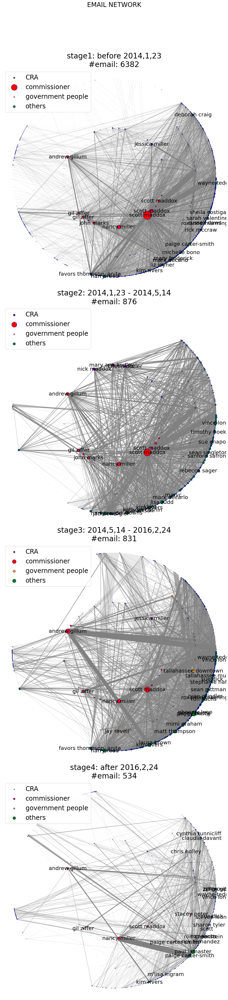

In [29]:
# 
fig = plt.figure(figsize=(12,50))
fig.suptitle('EMAIL NETWORK',fontsize = 24, y=1.04)
start_time = time.time()
# fig.text(.5, 1.005, 'edge thickness: #emails weighted by #receivers, then normalized $\in$(0,1)\n node size: #emails related', fontsize = 20, ha='center')
for k in trange(4):
    # build adjmat
    df_temp = df_related_emails.iloc[idxes[k]]
    num_email = len(df_temp)
    adj_email_mat1 = np.zeros((len(unique_people),len(unique_people)))
    adj_email_mat2 = np.zeros((len(unique_people),len(unique_people)))

    from_list = df_temp['From'].values.tolist()
    to_list = df_temp['To'].values.tolist()
    cc_list = df_temp['CC'].values.tolist()
    num_TO_CC = df_temp['num_TO_CC'].values.tolist()

    for i in range(len(from_list)):
        s = name2id[from_list[i]] # id of the sender
        
        rs = to_list[i]
        for j in range(len(rs)):
            if rs[j] != ('', '', '') and rs[j] != ['', '', '']:
                r = name2id[rs[j]]  # id of the receiver
                adj_email_mat1[s,r] += 1
                adj_email_mat2[s,r] += 1/num_TO_CC[i]
        cs = cc_list[i]
        for j in range(len(cs)):
            if cs[j] != ('', '', '') and cs[j] != ['', '', '']:
                r = name2id[cs[j]]  # id of the receiver
                adj_email_mat1[s,r] += 1
                adj_email_mat2[s,r] += 1/num_TO_CC[i]
    print('t1', time.time()-start_time)
    
    adj_email_mat1 = adj_email_mat1 + adj_email_mat1.T
    adj_email_mat2 = adj_email_mat2 + adj_email_mat2.T
    
    adj_email_mat1 = np.triu(adj_email_mat1, 1)
    adj_email_mat2 = np.triu(adj_email_mat2, 1)
        
    adj_email_mat2 = adj_email_mat2/adj_email_mat2.max()
    
    print('matrix done, time:', time.time()-start_time)
    adj_mat = adj_email_mat2
        
    plt.subplot(4,1,k+1)
#     nodes = unique_people

    G = nx.Graph()
#     G.add_nodes_from(nodes)
    networks = [1,2,3,4]

    networks_list = []
    for i in range(len(unique_people)):
        if i in cra_idx_list:
            networks_list.append(1)
        elif i in commissioner_idx_list:
            networks_list.append(2)
        elif i in government_idx_list:
            networks_list.append(3)
        else:
            networks_list.append(4)
    print('seperated people by position, time:', time.time()-start_time)
        
    # map color
    node_network_map = dict(zip(nodes, networks_list))
    colors = ['purple', 'red', 'orange', 'green']
    color_map = dict(zip(networks, colors))

    mat = adj_email_mat2 # selecting the matrix use for plot
    
    # build graph from numpy array 
    G = nx.from_numpy_array(mat, create_using=nx.Graph)
    G = nx.relabel_nodes(G, id2name)   # relabel the node with corresponding names

    nodes_by_color = {val: [node for node in G if color_map[node_network_map[node]] == val]
                      for val in colors}
    print('Done adding edges and nodes:', time.time()-start_time)
    
    pos = nx.circular_layout(G) # calculate position
    radii = [5,8,10]  # set the diameter for the three circles

    for ea in pos.keys():
        new_r = 1
        if ea in nodes_by_color['red']:
            new_r = radii[0]
        elif ea in nodes_by_color['purple']:
            new_r = radii[0]
        elif ea in nodes_by_color['orange']:
            new_r = radii[1]
        elif ea in nodes_by_color['green']:
            new_r = radii[2]
        else:
            pass
        pos[ea] *= new_r   # reposition nodes as concentric circles
    
    # calculate edge width
    edge_width = []
    edges_list = G.edges()
    for s,t in edges_list:
        edge_width.append(mat[name2id[s],name2id[t]])
    edge_width = np.array(edge_width)
    edge_width = 20*edge_width
    
    # calculate node size
    node_size = mat.sum(axis=0)
    node_size = 100*node_size
    
    # select several most active people and label their names
    labeling_idx = node_size.argsort()[-25:][::-1]
    labels = {}
    for i in labeling_idx:
        node = id2name[i]
        labels[node] = node[0] + ' ' + node[1]
        
    # label the name from cra and commissioner group
#     for node,group in node_network_map.items():
#         if group == 1 or group == 2:
#             labels[node] = node[0] + ' ' + node[1]

    node_sizes = {}
    node_sizes['red'] = node_size[commissioner_idx_list]
    node_sizes['purple'] = node_size[cra_idx_list]
    node_sizes['orange'] = node_size[government_idx_list]
    node_sizes['green'] = node_size[[item for item in np.arange(len(unique_people)) if item not in (total_idx_list+government_idx_list)]]

    
    legend_labels = {'red': 'commissioner', 'purple':'CRA','orange': 'government people','green': 'others' }
    for color, node_names in nodes_by_color.items():
        local_node_size = node_sizes[color]
        nx.draw_networkx_nodes(G, pos=pos, node_size=local_node_size, edgecolors ='darkblue', nodelist=node_names, node_color=color, label=legend_labels[color])

    nx.draw_networkx_edges(G, pos=pos, width=edge_width, edge_color = 'grey')
    nx.draw_networkx_labels(G, pos=pos, labels=labels, font_size=20, font_color='black')
    plt.title('stage'+str(k+1)+': '+stage_labels[k] + '\n#email: '+str(num_email),fontsize = 28)
    plt.legend(fontsize = 24, loc=2)
    plt.axis('off')
    print('Done plotting:', time.time()-start_time)
    
plt.tight_layout()
# plt.savefig('Email_network3.png')
plt.show()


## all

In [25]:
# switch index, so that people in the center circle can be evenly distributed on the circle
new_idx = np.linspace(0,len(unique_people),len(total_idx_list)+1, dtype = int)[:-1]
for i in range(len(total_idx_list)):
    p1_idx = total_idx_list[i]
    p1 = unique_people[p1_idx]
    p2_idx = new_idx[i]
    p2 = unique_people[p2_idx]
    unique_people[p1_idx], unique_people[p2_idx] = p2, p1
    
    if p2_idx in government_idx_list:
        total_idx_list[i], government_idx_list[government_idx_list.index(p2_idx)] = p2_idx, p1_idx
    else:
        total_idx_list[i] = p2_idx
name2id, id2name = nameToIndexDict(unique_people)

cra_idx_list = total_idx_list[:len(cra_idx_list)]
commissioner_idx_list = total_idx_list[len(cra_idx_list):]
#     print(p1,p2)

t1 0.1241142749786377
matrix done, time: 16.311992168426514
seperated people by position, time: 16.677913904190063
Done adding edges and nodes: 24.963953256607056
Done plotting: 43.27266311645508
t1 43.30812931060791
matrix done, time: 59.51380705833435
seperated people by position, time: 59.88023519515991
Done adding edges and nodes: 68.09679317474365
Done plotting: 86.18538331985474
t1 86.25084352493286
matrix done, time: 102.63407969474792
seperated people by position, time: 103.01056671142578
Done adding edges and nodes: 111.2710235118866
Done plotting: 129.45325636863708
t1 129.51070857048035
matrix done, time: 145.72031140327454
seperated people by position, time: 146.07116103172302
Done adding edges and nodes: 154.35538625717163


DEBUG:matplotlib.axes._base:top of axes not in the figure, so title not moved
DEBUG:matplotlib.axes._base:top of axes not in the figure, so title not moved
DEBUG:matplotlib.axes._base:top of axes not in the figure, so title not moved
DEBUG:matplotlib.axes._base:top of axes not in the figure, so title not moved
DEBUG:matplotlib.axes._base:top of axes not in the figure, so title not moved
DEBUG:matplotlib.axes._base:top of axes not in the figure, so title not moved
DEBUG:matplotlib.axes._base:top of axes not in the figure, so title not moved
DEBUG:matplotlib.axes._base:top of axes not in the figure, so title not moved


Done plotting: 172.23140239715576



DEBUG:matplotlib.axes._base:top of axes not in the figure, so title not moved
DEBUG:matplotlib.axes._base:top of axes not in the figure, so title not moved
DEBUG:matplotlib.axes._base:top of axes not in the figure, so title not moved
DEBUG:matplotlib.axes._base:top of axes not in the figure, so title not moved
DEBUG:matplotlib.axes._base:top of axes not in the figure, so title not moved
DEBUG:matplotlib.axes._base:top of axes not in the figure, so title not moved
DEBUG:matplotlib.axes._base:top of axes not in the figure, so title not moved
DEBUG:matplotlib.axes._base:top of axes not in the figure, so title not moved
DEBUG:matplotlib.axes._base:top of axes not in the figure, so title not moved
DEBUG:matplotlib.axes._base:top of axes not in the figure, so title not moved
DEBUG:matplotlib.axes._base:top of axes not in the figure, so title not moved
DEBUG:matplotlib.axes._base:top of axes not in the figure, so title not moved


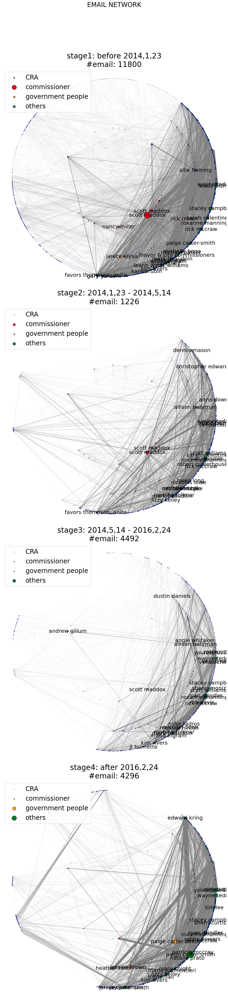

In [26]:
# 
fig = plt.figure(figsize=(12,50))
fig.suptitle('EMAIL NETWORK',fontsize = 24, y=1.04)
start_time = time.time()
# fig.text(.5, 1.005, 'edge thickness: #emails weighted by #receivers, then normalized $\in$(0,1)\n node size: #emails related', fontsize = 20, ha='center')
for k in trange(4):
    # build adjmat
    df_temp = df_email.iloc[idxes[k]]
    num_email = len(df_temp)
#     adj_email_mat1 = np.zeros((len(unique_people),len(unique_people)))
    adj_email_mat2 = np.zeros((len(unique_people),len(unique_people)))

    from_list = df_temp['From'].values.tolist()
    to_list = df_temp['To'].values.tolist()
    cc_list = df_temp['CC'].values.tolist()
    num_TO_CC = df_temp['num_TO_CC'].values.tolist()

    for i in range(len(from_list)):
        s = name2id[from_list[i]] # id of the sender
        
        rs = to_list[i]
        for j in range(len(rs)):
            if rs[j] != ('', '', '') and rs[j] != ['', '', '']:
                r = name2id[rs[j]]  # id of the receiver
#                 adj_email_mat1[s,r] += 1
                adj_email_mat2[s,r] += 1/num_TO_CC[i]
        cs = cc_list[i]
        for j in range(len(cs)):
            if cs[j] != ('', '', '') and cs[j] != ['', '', '']:
                r = name2id[cs[j]]  # id of the receiver
#                 adj_email_mat1[s,r] += 1
                adj_email_mat2[s,r] += 1/num_TO_CC[i]
    print('t1', time.time()-start_time)
    
#     adj_email_mat1 = adj_email_mat1 + adj_email_mat1.T
    adj_email_mat2 = adj_email_mat2 + adj_email_mat2.T
    
#     adj_email_mat1 = np.triu(adj_email_mat1, 1)
    adj_email_mat2 = np.triu(adj_email_mat2, 1)
        
    adj_email_mat2 = adj_email_mat2/adj_email_mat2.max()
    
    print('matrix done, time:', time.time()-start_time)
#     adj_mat = adj_email_mat2
        
    plt.subplot(4,1,k+1)
    nodes = unique_people

    G = nx.Graph()
#     G.add_nodes_from(nodes)
    networks = [1,2,3,4]

    networks_list = []
    for i in range(len(unique_people)):
        if i in cra_idx_list:
            networks_list.append(1)
        elif i in commissioner_idx_list:
            networks_list.append(2)
        elif i in government_idx_list:
            networks_list.append(3)
        else:
            networks_list.append(4)
    print('seperated people by position, time:', time.time()-start_time)
        
    # map color
    node_network_map = dict(zip(nodes, networks_list))
    colors = ['purple', 'red', 'orange', 'green']
    color_map = dict(zip(networks, colors))

#     mat = adj_email_mat2 # selecting the matrix use for plot
    
    # build graph from numpy array 
    G = nx.from_numpy_array(adj_email_mat2, create_using=nx.Graph)
    G = nx.relabel_nodes(G, id2name)   # relabel the node with corresponding names

    nodes_by_color = {val: [node for node in G if color_map[node_network_map[node]] == val]
                      for val in colors}
    print('Done adding edges and nodes:', time.time()-start_time)
    
    pos = nx.circular_layout(G) # calculate position
    radii = [5,8,10]  # set the diameter for the three circles

    for ea in pos.keys():
        new_r = 1
        if ea in nodes_by_color['red']:
            new_r = radii[0]
        elif ea in nodes_by_color['purple']:
            new_r = radii[0]
        elif ea in nodes_by_color['orange']:
            new_r = radii[1]
        elif ea in nodes_by_color['green']:
            new_r = radii[2]
        else:
            pass
        pos[ea] *= new_r   # reposition nodes as concentric circles
    
    # calculate edge width
    edge_width = []
    edges_list = G.edges()
    for s,t in edges_list:
        edge_width.append(adj_email_mat2[name2id[s],name2id[t]])
    edge_width = np.array(edge_width)
    edge_width = 20*edge_width
    
    # calculate node size
    node_size = adj_email_mat2.sum(axis=0)
    node_size = 100*node_size
    
    # select several most active people and label their names
    labeling_idx = node_size.argsort()[-25:][::-1]
    labels = {}
    for i in labeling_idx:
        node = id2name[i]
        labels[node] = node[0] + ' ' + node[1]
        
    # label the name from cra and commissioner group
#     for node,group in node_network_map.items():
#         if group == 1 or group == 2:
#             labels[node] = node[0] + ' ' + node[1]

    node_sizes = {}
    node_sizes['red'] = node_size[commissioner_idx_list]
    node_sizes['purple'] = node_size[cra_idx_list]
    node_sizes['orange'] = node_size[government_idx_list]
    node_sizes['green'] = node_size[[item for item in np.arange(len(unique_people)) if item not in (total_idx_list+government_idx_list)]]

    
    legend_labels = {'red': 'commissioner', 'purple':'CRA','orange': 'government people','green': 'others' }
    for color, node_names in nodes_by_color.items():
        local_node_size = node_sizes[color]
        nx.draw_networkx_nodes(G, pos=pos, node_size=local_node_size, edgecolors='darkblue', nodelist=node_names, node_color=color, label=legend_labels[color])

    nx.draw_networkx_edges(G, pos=pos, width=edge_width, edge_color = 'grey')
    nx.draw_networkx_labels(G, pos=pos, labels=labels, font_size=20, font_color='black')
    plt.title('stage'+str(k+1)+': '+stage_labels[k] + '\n#email: '+str(num_email),fontsize = 28)
    plt.legend(fontsize = 24, loc=2)
    plt.axis('off')
    print('Done plotting:', time.time()-start_time)
    adj_email_mat2 = None
    
plt.tight_layout()
# plt.savefig('Email_network3.png')
plt.show()


# combine emails from the same person (Mar 12)

Run the section 2 and 3. Then come here

## all

In [13]:
# cra
cra_dict = {}
cra_dict[('john', 'dailey','john_dailey_combined')] = [0]
cra_dict[('bryan', 'desloge', 'bryan_desloge_combined')] = [1,2,3,4]
cra_dict[('jessica', 'miller','jessica_miller_combined')] = [5]
cra_dict[('jane', 'sauls','jane_sauls_combined')] = [6]
cra_dict[('nick', 'maddox','nick_maddox_combined')] = [7,8]
cra_dict[('mary', 'lindley','mary_lindley_combined')] = [9,10,11]
cra_dict[('kristin', 'dozier','kristin_dozier_combined')] = [12,13,14,15]
cra_dict[('bill', 'proctor','bill_proctor_combined')] = [16]

# commissioner
commissioner_dict = {}
commissioner_dict[('scott', 'maddox','scott_maddox_combined')] = [0,1,2,3,4,5,6,7,8,9]
commissioner_dict[('andrew', 'gillum','andrew_gillum_combined')] = [10,11,12,13,14,15,16,17,18]
commissioner_dict[('mark', 'mustian','mark_mustian_combined')] = [19,20,21,22,23]
commissioner_dict[('gil', 'ziffer','gil_ziffer_combined')] = [24,25]
commissioner_dict[('curtis', 'richardson','curtis_richardson_combined')] = [26,27,28,29]
commissioner_dict[('nancy', 'miller','nancy_miller_combined')] = [30,31]
commissioner_dict[('john', 'marks','john_marks_combined')] = [32,33]


In [14]:
nodes_to_add = list(cra_dict.keys()) + list(commissioner_dict.keys())
nodes_to_add

[('john', 'dailey', 'john_dailey_combined'),
 ('bryan', 'desloge', 'bryan_desloge_combined'),
 ('jessica', 'miller', 'jessica_miller_combined'),
 ('jane', 'sauls', 'jane_sauls_combined'),
 ('nick', 'maddox', 'nick_maddox_combined'),
 ('mary', 'lindley', 'mary_lindley_combined'),
 ('kristin', 'dozier', 'kristin_dozier_combined'),
 ('bill', 'proctor', 'bill_proctor_combined'),
 ('scott', 'maddox', 'scott_maddox_combined'),
 ('andrew', 'gillum', 'andrew_gillum_combined'),
 ('mark', 'mustian', 'mark_mustian_combined'),
 ('gil', 'ziffer', 'gil_ziffer_combined'),
 ('curtis', 'richardson', 'curtis_richardson_combined'),
 ('nancy', 'miller', 'nancy_miller_combined'),
 ('john', 'marks', 'john_marks_combined')]

In [15]:
num_people = len(unique_people)
idx_mapping = {}
cra_idx_list_new = []
for person,idx_list in cra_dict.items():
    global_indices = []
    for idx in idx_list:
        global_idx = unique_people.index(cra_list[idx])
        global_indices.append(global_idx)
    idx_mapping[num_people] = global_indices
    num_people +=1
    cra_idx_list_new.append(num_people) 
commissioner_idx_list_new = []
for person,idx_list in commissioner_dict.items():
    global_indices = []
    for idx in idx_list:
        global_idx = unique_people.index(commissioner_list[idx])
        global_indices.append(global_idx)
    idx_mapping[num_people] = global_indices
    num_people +=1 
    commissioner_idx_list_new.append(num_people) 
    

total_idx_list_new = cra_idx_list_new + commissioner_idx_list_new
total_idx_list_new = np.array(total_idx_list_new) - len(total_idx_list) - 1
total_idx_list_new = total_idx_list_new.tolist()
cra_idx_list_new = total_idx_list_new[:len(cra_idx_list_new)]
commissioner_idx_list_new = total_idx_list_new[len(cra_idx_list_new):]

In [17]:
def combine_nodes(adj_mat, idx_mapping, unique_people, nodes_to_add):
    size1 = adj_mat.shape[0]
    size2 = size1 + len(idx_mapping)
    idx_to_remove = []
    for k,v in idx_mapping.items():
        new_r = np.zeros(size1)
        for r_idx in v:
            new_r += adj_mat[r_idx,:]
            idx_to_remove.append(r_idx)
        adj_mat = np.vstack((adj_mat,new_r))

    for k,v in idx_mapping.items():
        new_c = np.zeros(size2)
        for c_idx in v:
            new_c += adj_mat[:,c_idx]
        adj_mat = np.hstack((adj_mat,new_c.reshape(-1,1)))
    
    adj_mat = np.delete(adj_mat, idx_to_remove, axis=0)
    adj_mat = np.delete(adj_mat, idx_to_remove, axis=1)
    
    unique_people = np.array(unique_people)
    unique_people = np.delete(unique_people, idx_to_remove, axis=0)
    unique_people = unique_people.tolist()
    unique_people = standardize_triplet(unique_people)
    unique_people += nodes_to_add
    return adj_mat, unique_people

In [18]:
def switch_index(adj_mat, unique_people, total_idx_list, cra_idx_list, commissioner_idx_list, government_idx_list):
    unique_people_output = unique_people.copy()
    new_idx = np.linspace(0,len(unique_people),len(total_idx_list)+1, dtype = int)[:-1]
    for i in range(len(total_idx_list)):
        p1_idx = total_idx_list[i]
        p1 = unique_people[p1_idx]
        p2_idx = new_idx[i]
        p2 = unique_people[p2_idx]
        unique_people_output[p1_idx], unique_people_output[p2_idx] = p2, p1
        adj_mat[:,[p1_idx, p2_idx]] = adj_mat[:,[p2_idx, p1_idx]]
        adj_mat[[p1_idx, p2_idx],:] = adj_mat[[p2_idx, p1_idx],:]
        
        if p2_idx in government_idx_list:
            total_idx_list[i], government_idx_list[government_idx_list.index(p2_idx)] = p2_idx, p1_idx
        else:
            total_idx_list[i] = p2_idx

#     name2id, id2name = nameToIndexDict(unique_people)

    cra_idx_list = total_idx_list[:len(cra_idx_list)]
    commissioner_idx_list = total_idx_list[len(cra_idx_list):]
    print(unique_people_output[-10:])
    print(cra_idx_list)
    print(commissioner_idx_list)
    
    return adj_mat, unique_people_output, total_idx_list, cra_idx_list, commissioner_idx_list, government_idx_list

t1 0.11085653305053711
matrix done, time: 16.95527148246765
nodes combined, time: 65.17283964157104
government_idx_list updated, time: 65.88416337966919
nodes switched, time: 65.90344071388245
seperated people by position, time: 66.04850029945374
Done adding edges and nodes: 74.78865766525269
Done plotting: 89.43838739395142
t1 89.476478099823
matrix done, time: 106.62037014961243
nodes combined, time: 155.03064632415771
government_idx_list updated, time: 155.73736953735352
nodes switched, time: 155.75605034828186
seperated people by position, time: 155.90018272399902
Done adding edges and nodes: 164.56255793571472
Done plotting: 178.92597818374634
t1 178.9937391281128
matrix done, time: 195.83620500564575
nodes combined, time: 243.39307022094727
government_idx_list updated, time: 244.07968878746033
nodes switched, time: 244.0985462665558
seperated people by position, time: 244.24343276023865
Done adding edges and nodes: 252.69125366210938
Done plotting: 266.9747619628906
t1 267.031671

DEBUG:matplotlib.axes._base:top of axes not in the figure, so title not moved
DEBUG:matplotlib.axes._base:top of axes not in the figure, so title not moved
DEBUG:matplotlib.axes._base:top of axes not in the figure, so title not moved
DEBUG:matplotlib.axes._base:top of axes not in the figure, so title not moved
DEBUG:matplotlib.axes._base:top of axes not in the figure, so title not moved
DEBUG:matplotlib.axes._base:top of axes not in the figure, so title not moved
DEBUG:matplotlib.axes._base:top of axes not in the figure, so title not moved
DEBUG:matplotlib.axes._base:top of axes not in the figure, so title not moved


Done plotting: 355.48913955688477



DEBUG:matplotlib.axes._base:top of axes not in the figure, so title not moved
DEBUG:matplotlib.axes._base:top of axes not in the figure, so title not moved
DEBUG:matplotlib.axes._base:top of axes not in the figure, so title not moved
DEBUG:matplotlib.axes._base:top of axes not in the figure, so title not moved
DEBUG:matplotlib.axes._base:top of axes not in the figure, so title not moved
DEBUG:matplotlib.axes._base:top of axes not in the figure, so title not moved
DEBUG:matplotlib.axes._base:top of axes not in the figure, so title not moved
DEBUG:matplotlib.axes._base:top of axes not in the figure, so title not moved
DEBUG:matplotlib.axes._base:top of axes not in the figure, so title not moved
DEBUG:matplotlib.axes._base:top of axes not in the figure, so title not moved
DEBUG:matplotlib.axes._base:top of axes not in the figure, so title not moved
DEBUG:matplotlib.axes._base:top of axes not in the figure, so title not moved


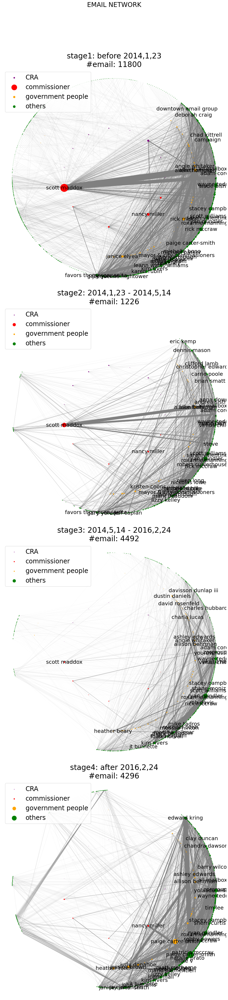

In [28]:
# 
adj_email_mat2 = None
normalizing_factors = []

fig = plt.figure(figsize=(12,50))
fig.suptitle('EMAIL NETWORK',fontsize = 24, y=1.04)
start_time = time.time()
# fig.text(.5, 1.005, 'edge thickness: #emails weighted by #receivers, then normalized $\in$(0,1)\n node size: #emails related', fontsize = 20, ha='center')
for k in trange(4):
    # build adjmat
    df_temp = df_email.iloc[idxes[k]]
    num_email = len(df_temp)
#     adj_email_mat1 = np.zeros((len(unique_people),len(unique_people)))
    adj_email_mat2 = np.zeros((len(unique_people),len(unique_people)))

    from_list = df_temp['From'].values.tolist()
    to_list = df_temp['To'].values.tolist()
    cc_list = df_temp['CC'].values.tolist()
    num_TO_CC = df_temp['num_TO_CC'].values.tolist()

    for i in range(len(from_list)):
        s = name2id[from_list[i]] # id of the sender
        
        rs = to_list[i]
        for j in range(len(rs)):
            if rs[j] != ('', '', '') and rs[j] != ['', '', '']:
                r = name2id[rs[j]]  # id of the receiver
#                 adj_email_mat1[s,r] += 1
                adj_email_mat2[s,r] += 1/num_TO_CC[i]
        cs = cc_list[i]
        for j in range(len(cs)):
            if cs[j] != ('', '', '') and cs[j] != ['', '', '']:
                r = name2id[cs[j]]  # id of the receiver
#                 adj_email_mat1[s,r] += 1
                adj_email_mat2[s,r] += 1/num_TO_CC[i]
    print('t1', time.time()-start_time)
    
#     adj_email_mat1 = adj_email_mat1 + adj_email_mat1.T
    adj_email_mat2 = adj_email_mat2 + adj_email_mat2.T
    
#     adj_email_mat1 = np.triu(adj_email_mat1, 1)
    adj_email_mat2 = np.triu(adj_email_mat2, 1)
        
    adj_email_mat2 = adj_email_mat2/adj_email_mat2.max()
    
    normalizing_factors.append(adj_email_mat2.max()) # save it for later use
    
    print('matrix done, time:', time.time()-start_time)
    
    unique_people_combined = unique_people.copy()
    size1 = adj_email_mat2.shape[0]
    size2 = size1 + len(idx_mapping)
    idx_to_remove = []
    for _,v in idx_mapping.items():
        new_r = np.zeros(size1)
        for r_idx in v:
            new_r += adj_email_mat2[r_idx,:]
            idx_to_remove.append(r_idx)
        adj_email_mat2 = np.vstack((adj_email_mat2,new_r))

    for _,v in idx_mapping.items():
        new_c = np.zeros(size2)
        for c_idx in v:
            new_c += adj_email_mat2[:,c_idx]
        adj_email_mat2 = np.hstack((adj_email_mat2,new_c.reshape(-1,1)))
    
    adj_email_mat2 = np.delete(adj_email_mat2, idx_to_remove, axis=0)
    adj_email_mat2 = np.delete(adj_email_mat2, idx_to_remove, axis=1)
    
    unique_people_combined = np.array(unique_people_combined)
    unique_people_combined = np.delete(unique_people_combined, idx_to_remove, axis=0)
    unique_people_combined = unique_people_combined.tolist()
    unique_people_combined = standardize_triplet(unique_people_combined)
    unique_people_combined += nodes_to_add
    
#     adj_email_mat2, unique_people_combined = combine_nodes(adj_email_mat2, idx_mapping, unique_people, nodes_to_add)
    
    print('nodes combined, time:', time.time()-start_time)
    
    government_idx_list_new = []
    for i,people in enumerate(unique_people_combined):
        for j,people2 in enumerate(gorvenment_people_list):
            if people[2] == people2[2] or (people[0] == people2[0] and people[1] == people2[1]):
                if i not in cra_idx_list_new and i not in commissioner_idx_list_new :
                    government_idx_list_new.append(i)
                    break
    print('government_idx_list updated, time:', time.time()-start_time)
    
    government_idx_list_new2 = government_idx_list_new.copy()
    total_idx_list_new2 = total_idx_list_new.copy()
    new_idx = np.linspace(0,len(unique_people_combined),len(total_idx_list_new)+1, dtype = int)[:-1]
    for i in range(len(total_idx_list_new2)):
        p1_idx = total_idx_list_new2[i]
        p1 = unique_people_combined[p1_idx]
        p2_idx = new_idx[i]
        p2 = unique_people_combined[p2_idx]
        unique_people_combined[p1_idx], unique_people_combined[p2_idx] = p2, p1
        adj_email_mat2[:,[p1_idx, p2_idx]] = adj_email_mat2[:,[p2_idx, p1_idx]]
        adj_email_mat2[[p1_idx, p2_idx],:] = adj_email_mat2[[p2_idx, p1_idx],:]
        
        if p2_idx in government_idx_list_new2:
            total_idx_list_new2[i], government_idx_list_new2[government_idx_list_new.index(p2_idx)] = p2_idx, p1_idx
        else:
            total_idx_list_new2[i] = p2_idx

#     name2id, id2name = nameToIndexDict(unique_people)

    cra_idx_list_new2 = total_idx_list_new2[:len(cra_idx_list_new)]
    commissioner_idx_list_new2 = total_idx_list_new2[len(cra_idx_list_new):]
#     adj_email_mat2, unique_people_combined2, total_idx_list_new2, cra_idx_list_new2, commissioner_idx_list_new2, government_idx_list_new2 = switch_index(adj_email_mat2, unique_people_combined, total_idx_list_new, cra_idx_list_new, commissioner_idx_list_new, government_idx_list_new)
    name2id_new2, id2name_new2 = nameToIndexDict(unique_people_combined)
    
    print('nodes switched, time:', time.time()-start_time)
    
    plt.subplot(4,1,k+1)
#     nodes = unique_people_combined

    G = nx.Graph()
#     G.add_nodes_from(nodes)
    networks = [1,2,3,4]

    networks_list = []
    for i in range(len(unique_people_combined)):
        if i in cra_idx_list_new2:
            networks_list.append(1)
        elif i in commissioner_idx_list_new2:
            networks_list.append(2)
        elif i in government_idx_list_new2:
            networks_list.append(3)
        else:
            networks_list.append(4)
    print('seperated people by position, time:', time.time()-start_time)
        
    # map color
    node_network_map = dict(zip(unique_people_combined, networks_list))
    colors = ['purple', 'red', 'orange', 'green']
    color_map = dict(zip(networks, colors))

    # build graph from numpy array 
    G = nx.from_numpy_array(adj_email_mat2, create_using=nx.Graph)
    G = nx.relabel_nodes(G, id2name_new2)   # relabel the node with corresponding names

    nodes_by_color = {val: [node for node in G if color_map[node_network_map[node]] == val]
                      for val in colors}
    print('Done adding edges and nodes:', time.time()-start_time)
    
    pos = nx.circular_layout(G) # calculate position
    radii = [5,8,10]  # set the diameter for the three circles

    for ea in pos.keys():
        new_r = 1
        if ea in nodes_by_color['red']:
            new_r = radii[0]
        elif ea in nodes_by_color['purple']:
            new_r = radii[0]
        elif ea in nodes_by_color['orange']:
            new_r = radii[1]
        elif ea in nodes_by_color['green']:
            new_r = radii[2]
        else:
            pass
        pos[ea] *= new_r   # reposition nodes as concentric circles
    
    # calculate edge width
    edge_width = []
    edges_list = G.edges()
    for s,t in edges_list:
        edge_width.append(adj_email_mat2[name2id_new2[s],name2id_new2[t]])
    edge_width = np.array(edge_width)
    edge_width = 20*edge_width
    
    # calculate node size
    node_size = adj_email_mat2.sum(axis=0)
    node_size = 100*node_size
    
    # select several most active people and label their names
    labeling_idx = node_size.argsort()[-25:][::-1].tolist()
    
    # select several strongest communication and label their nodes
    labeling_edge_idx = edge_width.argsort()[-25:][::-1]
    for i in labeling_edge_idx:
        labeling_idx.append(name2id_new2[list(G.edges())[i][0]])
        labeling_idx.append(name2id_new2[list(G.edges())[i][1]])
        
    labeling_idx = list(set(labeling_idx)) 
    labels = {}
    for i in labeling_idx:
        node = id2name_new2[i]
        labels[node] = node[0] + ' ' + node[1]
        
    # label the name from cra and commissioner group
#     for node,group in node_network_map.items():
#         if group == 1 or group == 2:
#             labels[node] = node[0] + ' ' + node[1]

    node_sizes = {}
    node_sizes['red'] = node_size[commissioner_idx_list_new2]
    node_sizes['purple'] = node_size[cra_idx_list_new2]
    node_sizes['orange'] = node_size[government_idx_list_new2]
    node_sizes['green'] = node_size[[item for item in np.arange(len(unique_people_combined)) if item not in (total_idx_list_new2+government_idx_list_new2)]]

    
    legend_labels = {'red': 'commissioner', 'purple':'CRA','orange': 'government people','green': 'others' }
    for color, node_names in nodes_by_color.items():
        nx.draw_networkx_nodes(G, pos=pos, node_size=node_sizes[color], nodelist=node_names, node_color=color, label=legend_labels[color])

    nx.draw_networkx_edges(G, pos=pos, width=edge_width, edge_color = 'grey')
    nx.draw_networkx_labels(G, pos=pos, labels=labels, font_size=20, font_color='black')
    plt.title('stage'+str(k+1)+': '+stage_labels[k] + '\n#email: '+str(num_email),fontsize = 28)
    plt.legend(fontsize = 24, loc=2)
    plt.axis('off')
    print('Done plotting:', time.time()-start_time)
    
    # release memory, especially adj_email_mat2, otherwise it will crash
    adj_email_mat2 = None
#     unique_people_combined = None
#     unique_people_combined2 = None
#     adj_mat = None

plt.tight_layout()
plt.show()


## CRA and commmisioner related

Run all necessary sections again!

In [43]:
# find all CRA and commissioner related emails
keep_idx=[]
for i in range(len(from_list)):
    for j in range(len(total_list)):
        if total_list[j] == from_list[i] :
            keep_idx.append(i)
            break
        for t in to_list[i]:
            if total_list[j] == t:
                keep_idx.append(i)
                break
        for cc in cc_list[i]:
            if total_list[j] == cc:
                keep_idx.append(i)
                break
len(keep_idx)

8623

In [44]:
df_related_emails = df_email.iloc[keep_idx]
df_related_emails = df_related_emails.reset_index(drop=True)
df_related_emails

,From,Sent,To,CC,Subject,Attachments,Importance,Body,textblob_sentiment,nltk_sentiment,flair_sentiment,GCP_sentiment,num_TO,num_CC,num_TO_CC
0,"(deborah, heiter, deborah.heiter@talgov.com)",2012-01-20 16:41:00,"[(bill, behenna, bill_behenna), (cathy, branch...",[],[],[],[],"['', 'Deborah L. Heiter', 'Administrative Spec...","[0.07253787878787879, 0.3424242424242424]","[0.9318, 0.0, 0.93, 0.07]",POSITIVE (0.8154),"[0.0, 2.799999952316284, 0.009523809361620015]",31,0,31
1,"(deborah, heiter, deborah.heiter@talgov.com)",2012-01-20 16:41:00,"[(bill, behenna, bill_behenna), (cathy, branch...",[],[],[],[],"['', 'Deborah L. Heiter', 'Administrative Spec...","[0.07253787878787879, 0.3424242424242424]","[0.9318, 0.0, 0.93, 0.07]",POSITIVE (0.8154),"[0.0, 2.799999952316284, 0.009523809361620015]",31,0,31
2,"(diana, oropallo, doropallo@comcast.net)",2012-04-02 22:07:00,"[(sheila, costigan, costigans@leonschools.net)...","[("", "", , "", ""_ )]",[],[],[],"['Just to piggy back on Sheilas email, your at...","[0.18214285714285716, 0.4107142857142857]","[0.9778, 0.0, 0.818, 0.182]",POSITIVE (0.8923),"[0.4000000059604645, 4.5, 0.02601156069364162]",63,1,64
3,"(diana, oropallo, doropallo@comcast.net)",2012-04-02 22:07:00,"[(sheila, costigan, costigans@leonschools.net)...","[("", "", , "", ""_ )]",[],[],[],"['Just to piggy back on Sheilas email, your at...","[0.18214285714285716, 0.4107142857142857]","[0.9778, 0.0, 0.818, 0.182]",POSITIVE (0.8923),"[0.4000000059604645, 4.5, 0.02601156069364162]",63,1,64
4,"(sheila, costigan, costigans@leonschools.net)",2012-04-04 14:12:00,"[(leslie, smith, lesliehsmith@gmail.com), (adm...",[],['March Executive Director Report'],['FLCS.EX.DIR.report.March.2012.docx; STOMP.CO...,[],"['REPORT.docx', 'Dear BOD, please find attache...","[0.16754086727666279, 0.40936088154269956]","[0.9993, 0.005, 0.827, 0.168]",POSITIVE (0.9924),"[0.20000000298023224, 17.299999237060547, 0.01...",29,0,29
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
8618,"(edward, holifield, ewholifield@yahoo.com)",2017-09-07 00:45:00,"[(paul, lamaster, paullamaster250@comcast.net)...",[],[],[],[],"['', 'And all for the entertainment of the pow...","[0.2571794871794872, 0.49282051282051287]","[0.8795, 0.023, 0.863, 0.115]",POSITIVE (0.9932),"[0.10000000149011612, 6.400000095367432, 0.041...",58,0,58
8619,"(edward, holifield, ewholifield@yahoo.com)",2017-09-07 00:45:00,"[(paul, lamaster, paullamaster250@comcast.net)...",[],[],[],[],"['', 'And all for the entertainment of the pow...","[0.2571794871794872, 0.49282051282051287]","[0.8795, 0.023, 0.863, 0.115]",POSITIVE (0.9932),"[0.10000000149011612, 6.400000095367432, 0.041...",58,0,58
8620,"(edward, holifield, ewholifield@yahoo.com)",2017-09-07 00:45:00,"[(paul, lamaster, paullamaster250@comcast.net)...",[],[],[],[],"['', 'And all for the entertainment of the pow...","[0.2571794871794872, 0.49282051282051287]","[0.8795, 0.023, 0.863, 0.115]",POSITIVE (0.9932),"[0.10000000149011612, 6.400000095367432, 0.041...",58,0,58
8621,"(edward, holifield, ewholifield@yahoo.com)",2017-09-07 00:45:00,"[(paul, lamaster, paullamaster250@comcast.net)...",[],[],[],[],"['', 'And all for the entertainment of the pow...","[0.2571794871794872, 0.49282051282051287]","[0.8795, 0.023, 0.863, 0.115]",POSITIVE (0.9932),"[0.10000000149011612, 6.400000095367432, 0.041...",58,0,58


In [45]:
from_list = df_related_emails['From'].values.tolist()
to_list = df_related_emails['To'].values.tolist()
cc_list = df_related_emails['CC'].values.tolist()


from_list = standardize_triplet(from_list)
to_list = standardize_triplet(to_list)
cc_list = standardize_triplet(cc_list)

In [46]:
num_TO = []
num_TO = []
num_CC = []
num_TO_CC = []
for i in range(len(to_list)):
    num_TO.append(len(to_list[i]))
    num_CC.append(len(cc_list[i]))
    num_TO_CC.append(len(to_list[i]) + len(cc_list[i]))
df_related_emails['num_TO'] = num_TO
df_related_emails['num_CC'] = num_CC
df_related_emails['num_TO_CC'] = num_TO_CC

In [47]:
unique_people = set()
for i in range(len(from_list)):
    unique_people.add(from_list[i])

for i in range(len(cc_list)):
    for lst in cc_list[i]:
        unique_people.add(lst)

for i in range(len(to_list)):
    for lst in to_list[i]:
        unique_people.add(lst)
unique_people = list(unique_people)
unique_people.sort()
name2id, id2name = nameToIndexDict(unique_people)

len(unique_people)


22775

In [48]:
cra_idx_list = []
for i,people in enumerate(unique_people):
    if people in cra_list:
        cra_idx_list.append(i)
#         print(people)
len(cra_idx_list)

17

In [49]:
commissioner_idx_list = []
for i,people in enumerate(unique_people):
    if people in commissioner_list:
        commissioner_idx_list.append(i)
#         print(people)
len(commissioner_idx_list)

34

In [50]:
total_idx_list = cra_idx_list + commissioner_idx_list

In [51]:
government_idx_list = []
for i,people in enumerate(unique_people):
    for j,people2 in enumerate(gorvenment_people_list):
        if people[2] == people2[2] or (people[0] == people2[0] and people[1] == people2[1]):
            if i not in cra_idx_list and i not in commissioner_idx_list :
                government_idx_list.append(i)
                break
len(government_idx_list)

135

In [52]:
# seperate emails by sent time
date_email = pd.to_datetime(df_related_emails['Sent'])
idxt1 = date_email>datetime(2014,1,23)
idxt2 = date_email>datetime(2014,5,14)
idxt3 = date_email>datetime(2016,2,24)
idxe1 = np.array(idxt1==False)
idxe2 = np.array((idxt1==True) & (idxt2==False))
idxe3 = np.array((idxt2==True) & (idxt3==False))
idxe4 = np.array(idxt3==True)

idxes = [idxe1, idxe2, idxe3, idxe4]
stage_labels = ['before 2014,1,23', '2014,1,23 - 2014,5,14', '2014,5,14 - 2016,2,24', 'after 2016,2,24']

In [53]:
# cra
cra_dict = {}
cra_dict[('john', 'dailey','john_dailey_combined')] = [0]
cra_dict[('bryan', 'desloge', 'bryan_desloge_combined')] = [1,2,3,4]
cra_dict[('jessica', 'miller','jessica_miller_combined')] = [5]
cra_dict[('jane', 'sauls','jane_sauls_combined')] = [6]
cra_dict[('nick', 'maddox','nick_maddox_combined')] = [7,8]
cra_dict[('mary', 'lindley','mary_lindley_combined')] = [9,10,11]
cra_dict[('kristin', 'dozier','kristin_dozier_combined')] = [12,13,14,15]
cra_dict[('bill', 'proctor','bill_proctor_combined')] = [16]

# commissioner
commissioner_dict = {}
commissioner_dict[('scott', 'maddox','scott_maddox_combined')] = [0,1,2,3,4,5,6,7,8,9]
commissioner_dict[('andrew', 'gillum','andrew_gillum_combined')] = [10,11,12,13,14,15,16,17,18]
commissioner_dict[('mark', 'mustian','mark_mustian_combined')] = [19,20,21,22,23]
commissioner_dict[('gil', 'ziffer','gil_ziffer_combined')] = [24,25]
commissioner_dict[('curtis', 'richardson','curtis_richardson_combined')] = [26,27,28,29]
commissioner_dict[('nancy', 'miller','nancy_miller_combined')] = [30,31]
commissioner_dict[('john', 'marks','john_marks_combined')] = [32,33]


In [54]:
nodes_to_add = list(cra_dict.keys()) + list(commissioner_dict.keys())
nodes_to_add

[('john', 'dailey', 'john_dailey_combined'),
 ('bryan', 'desloge', 'bryan_desloge_combined'),
 ('jessica', 'miller', 'jessica_miller_combined'),
 ('jane', 'sauls', 'jane_sauls_combined'),
 ('nick', 'maddox', 'nick_maddox_combined'),
 ('mary', 'lindley', 'mary_lindley_combined'),
 ('kristin', 'dozier', 'kristin_dozier_combined'),
 ('bill', 'proctor', 'bill_proctor_combined'),
 ('scott', 'maddox', 'scott_maddox_combined'),
 ('andrew', 'gillum', 'andrew_gillum_combined'),
 ('mark', 'mustian', 'mark_mustian_combined'),
 ('gil', 'ziffer', 'gil_ziffer_combined'),
 ('curtis', 'richardson', 'curtis_richardson_combined'),
 ('nancy', 'miller', 'nancy_miller_combined'),
 ('john', 'marks', 'john_marks_combined')]

In [55]:
num_people = len(unique_people)
idx_mapping = {}
cra_idx_list_new = []
for person,idx_list in cra_dict.items():
    global_indices = []
    for idx in idx_list:
        global_idx = unique_people.index(cra_list[idx])
        global_indices.append(global_idx)
    idx_mapping[num_people] = global_indices
    num_people +=1
    cra_idx_list_new.append(num_people) 
commissioner_idx_list_new = []
for person,idx_list in commissioner_dict.items():
    global_indices = []
    for idx in idx_list:
        global_idx = unique_people.index(commissioner_list[idx])
        global_indices.append(global_idx)
    idx_mapping[num_people] = global_indices
    num_people +=1 
    commissioner_idx_list_new.append(num_people) 
    

total_idx_list_new = cra_idx_list_new + commissioner_idx_list_new
total_idx_list_new = np.array(total_idx_list_new) - len(total_idx_list) - 1
total_idx_list_new = total_idx_list_new.tolist()
cra_idx_list_new = total_idx_list_new[:len(cra_idx_list_new)]
commissioner_idx_list_new = total_idx_list_new[len(cra_idx_list_new):]

t1 0.11132621765136719
matrix done, time: 5.8594982624053955
nodes combined, time: 23.489373207092285
government_idx_list updated, time: 23.91065287590027
nodes switched, time: 23.920987606048584
seperated people by position, time: 23.997742414474487
Done adding edges and nodes: 26.859530925750732
Done plotting: 32.64394521713257
t1 32.67752194404602
matrix done, time: 38.426920890808105
nodes combined, time: 55.438493967056274
government_idx_list updated, time: 55.85146522521973
nodes switched, time: 55.86335301399231
seperated people by position, time: 55.93797302246094
Done adding edges and nodes: 58.79309868812561
Done plotting: 64.59996843338013
t1 64.6562705039978
matrix done, time: 70.38632702827454
nodes combined, time: 87.55667519569397
government_idx_list updated, time: 87.97027468681335
nodes switched, time: 87.9816484451294
seperated people by position, time: 88.05699038505554
Done adding edges and nodes: 90.82005667686462
Done plotting: 96.60112476348877
t1 96.632039070129

DEBUG:matplotlib.axes._base:top of axes not in the figure, so title not moved
DEBUG:matplotlib.axes._base:top of axes not in the figure, so title not moved
DEBUG:matplotlib.axes._base:top of axes not in the figure, so title not moved
DEBUG:matplotlib.axes._base:top of axes not in the figure, so title not moved
DEBUG:matplotlib.axes._base:top of axes not in the figure, so title not moved
DEBUG:matplotlib.axes._base:top of axes not in the figure, so title not moved
DEBUG:matplotlib.axes._base:top of axes not in the figure, so title not moved
DEBUG:matplotlib.axes._base:top of axes not in the figure, so title not moved


Done plotting: 128.50565767288208



DEBUG:matplotlib.axes._base:top of axes not in the figure, so title not moved
DEBUG:matplotlib.axes._base:top of axes not in the figure, so title not moved
DEBUG:matplotlib.axes._base:top of axes not in the figure, so title not moved
DEBUG:matplotlib.axes._base:top of axes not in the figure, so title not moved
DEBUG:matplotlib.axes._base:top of axes not in the figure, so title not moved
DEBUG:matplotlib.axes._base:top of axes not in the figure, so title not moved
DEBUG:matplotlib.axes._base:top of axes not in the figure, so title not moved
DEBUG:matplotlib.axes._base:top of axes not in the figure, so title not moved
DEBUG:matplotlib.axes._base:top of axes not in the figure, so title not moved
DEBUG:matplotlib.axes._base:top of axes not in the figure, so title not moved
DEBUG:matplotlib.axes._base:top of axes not in the figure, so title not moved
DEBUG:matplotlib.axes._base:top of axes not in the figure, so title not moved


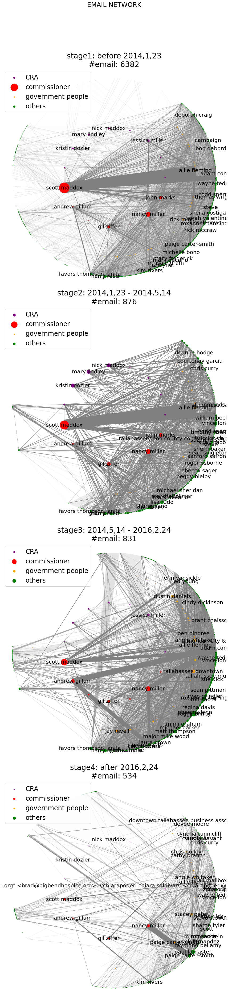

In [57]:
# 
adj_email_mat2 = None

fig = plt.figure(figsize=(12,50))
fig.suptitle('EMAIL NETWORK',fontsize = 24, y=1.04)
start_time = time.time()
# fig.text(.5, 1.005, 'edge thickness: #emails weighted by #receivers, then normalized $\in$(0,1)\n node size: #emails related', fontsize = 20, ha='center')
for k in trange(4):
    # build adjmat
    df_temp = df_related_emails.iloc[idxes[k]]
    num_email = len(df_temp)
#     adj_email_mat1 = np.zeros((len(unique_people),len(unique_people)))
    adj_email_mat2 = np.zeros((len(unique_people),len(unique_people)))

    from_list = df_temp['From'].values.tolist()
    to_list = df_temp['To'].values.tolist()
    cc_list = df_temp['CC'].values.tolist()
    num_TO_CC = df_temp['num_TO_CC'].values.tolist()

    for i in range(len(from_list)):
        s = name2id[from_list[i]] # id of the sender
        
        rs = to_list[i]
        for j in range(len(rs)):
            if rs[j] != ('', '', '') and rs[j] != ['', '', '']:
                r = name2id[rs[j]]  # id of the receiver
#                 adj_email_mat1[s,r] += 1
                adj_email_mat2[s,r] += 1/num_TO_CC[i]
        cs = cc_list[i]
        for j in range(len(cs)):
            if cs[j] != ('', '', '') and cs[j] != ['', '', '']:
                r = name2id[cs[j]]  # id of the receiver
#                 adj_email_mat1[s,r] += 1
                adj_email_mat2[s,r] += 1/num_TO_CC[i]
    print('t1', time.time()-start_time)
    
#     adj_email_mat1 = adj_email_mat1 + adj_email_mat1.T
    adj_email_mat2 = adj_email_mat2 + adj_email_mat2.T
    
#     adj_email_mat1 = np.triu(adj_email_mat1, 1)
    adj_email_mat2 = np.triu(adj_email_mat2, 1)
        
    adj_email_mat2 = adj_email_mat2/adj_email_mat2.max()
    
#     normalizing_factors.append(adj_email_mat2.max()) # save it for later use
    
    print('matrix done, time:', time.time()-start_time)
    
    unique_people_combined = unique_people.copy()
    size1 = adj_email_mat2.shape[0]
    size2 = size1 + len(idx_mapping)
    idx_to_remove = []
    for _,v in idx_mapping.items():
        new_r = np.zeros(size1)
        for r_idx in v:
            new_r += adj_email_mat2[r_idx,:]
            idx_to_remove.append(r_idx)
        adj_email_mat2 = np.vstack((adj_email_mat2,new_r))

    for _,v in idx_mapping.items():
        new_c = np.zeros(size2)
        for c_idx in v:
            new_c += adj_email_mat2[:,c_idx]
        adj_email_mat2 = np.hstack((adj_email_mat2,new_c.reshape(-1,1)))
    
    adj_email_mat2 = np.delete(adj_email_mat2, idx_to_remove, axis=0)
    adj_email_mat2 = np.delete(adj_email_mat2, idx_to_remove, axis=1)
    
    unique_people_combined = np.array(unique_people_combined)
    unique_people_combined = np.delete(unique_people_combined, idx_to_remove, axis=0)
    unique_people_combined = unique_people_combined.tolist()
    unique_people_combined = standardize_triplet(unique_people_combined)
    unique_people_combined += nodes_to_add
    
#     adj_email_mat2, unique_people_combined = combine_nodes(adj_email_mat2, idx_mapping, unique_people, nodes_to_add)
    
    print('nodes combined, time:', time.time()-start_time)
    
    government_idx_list_new = []
    for i,people in enumerate(unique_people_combined):
        for j,people2 in enumerate(gorvenment_people_list):
            if people[2] == people2[2] or (people[0] == people2[0] and people[1] == people2[1]):
                if i not in cra_idx_list_new and i not in commissioner_idx_list_new :
                    government_idx_list_new.append(i)
                    break
    print('government_idx_list updated, time:', time.time()-start_time)
    
    government_idx_list_new2 = government_idx_list_new.copy()
    total_idx_list_new2 = total_idx_list_new.copy()
    new_idx = np.linspace(0,len(unique_people_combined),len(total_idx_list_new)+1, dtype = int)[:-1]
    for i in range(len(total_idx_list_new2)):
        p1_idx = total_idx_list_new2[i]
        p1 = unique_people_combined[p1_idx]
        p2_idx = new_idx[i]
        p2 = unique_people_combined[p2_idx]
        unique_people_combined[p1_idx], unique_people_combined[p2_idx] = p2, p1
        adj_email_mat2[:,[p1_idx, p2_idx]] = adj_email_mat2[:,[p2_idx, p1_idx]]
        adj_email_mat2[[p1_idx, p2_idx],:] = adj_email_mat2[[p2_idx, p1_idx],:]
        
        if p2_idx in government_idx_list_new2:
            total_idx_list_new2[i], government_idx_list_new2[government_idx_list_new.index(p2_idx)] = p2_idx, p1_idx
        else:
            total_idx_list_new2[i] = p2_idx

#     name2id, id2name = nameToIndexDict(unique_people)

    cra_idx_list_new2 = total_idx_list_new2[:len(cra_idx_list_new)]
    commissioner_idx_list_new2 = total_idx_list_new2[len(cra_idx_list_new):]
#     adj_email_mat2, unique_people_combined2, total_idx_list_new2, cra_idx_list_new2, commissioner_idx_list_new2, government_idx_list_new2 = switch_index(adj_email_mat2, unique_people_combined, total_idx_list_new, cra_idx_list_new, commissioner_idx_list_new, government_idx_list_new)
    name2id_new2, id2name_new2 = nameToIndexDict(unique_people_combined)
    
    print('nodes switched, time:', time.time()-start_time)
    
    plt.subplot(4,1,k+1)
#     nodes = unique_people_combined

    G = nx.Graph()
#     G.add_nodes_from(nodes)
    networks = [1,2,3,4]

    networks_list = []
    for i in range(len(unique_people_combined)):
        if i in cra_idx_list_new2:
            networks_list.append(1)
        elif i in commissioner_idx_list_new2:
            networks_list.append(2)
        elif i in government_idx_list_new2:
            networks_list.append(3)
        else:
            networks_list.append(4)
    print('seperated people by position, time:', time.time()-start_time)
        
    # map color
    node_network_map = dict(zip(unique_people_combined, networks_list))
    colors = ['purple', 'red', 'orange', 'green']
    color_map = dict(zip(networks, colors))

    # build graph from numpy array 
    G = nx.from_numpy_array(adj_email_mat2, create_using=nx.Graph)
    G = nx.relabel_nodes(G, id2name_new2)   # relabel the node with corresponding names

    nodes_by_color = {val: [node for node in G if color_map[node_network_map[node]] == val]
                      for val in colors}
    print('Done adding edges and nodes:', time.time()-start_time)
    
    pos = nx.circular_layout(G) # calculate position
    radii = [5,8,10]  # set the diameter for the three circles

    for ea in pos.keys():
        new_r = 1
        if ea in nodes_by_color['red']:
            new_r = radii[0]
        elif ea in nodes_by_color['purple']:
            new_r = radii[0]
        elif ea in nodes_by_color['orange']:
            new_r = radii[1]
        elif ea in nodes_by_color['green']:
            new_r = radii[2]
        else:
            pass
        pos[ea] *= new_r   # reposition nodes as concentric circles
    
    # calculate edge width
    edge_width = []
    edges_list = G.edges()
    for s,t in edges_list:
        edge_width.append(adj_email_mat2[name2id_new2[s],name2id_new2[t]])
    edge_width = np.array(edge_width)
    edge_width = 20*edge_width
    
    # calculate node size
    node_size = adj_email_mat2.sum(axis=0)
    node_size = 100*node_size
    
    # select several most active people and label their names
    labeling_idx = node_size.argsort()[-25:][::-1].tolist()
    
    # select several strongest communication and label their nodes
    labeling_edge_idx = edge_width.argsort()[-25:][::-1]
    for i in labeling_edge_idx:
        labeling_idx.append(name2id_new2[list(G.edges())[i][0]])
        labeling_idx.append(name2id_new2[list(G.edges())[i][1]])
        
    labeling_idx = list(set(labeling_idx)) 
    labels = {}
    for i in labeling_idx:
        node = id2name_new2[i]
        labels[node] = node[0] + ' ' + node[1]
        
    # label the name from cra and commissioner group
#     for node,group in node_network_map.items():
#         if group == 1 or group == 2:
#             labels[node] = node[0] + ' ' + node[1]

    node_sizes = {}
    node_sizes['red'] = node_size[commissioner_idx_list_new2]
    node_sizes['purple'] = node_size[cra_idx_list_new2]
    node_sizes['orange'] = node_size[government_idx_list_new2]
    node_sizes['green'] = node_size[[item for item in np.arange(len(unique_people_combined)) if item not in (total_idx_list_new2+government_idx_list_new2)]]

    
    legend_labels = {'red': 'commissioner', 'purple':'CRA','orange': 'government people','green': 'others' }
    for color, node_names in nodes_by_color.items():
        nx.draw_networkx_nodes(G, pos=pos, node_size=node_sizes[color], nodelist=node_names, node_color=color, label=legend_labels[color])

    nx.draw_networkx_edges(G, pos=pos, width=edge_width, edge_color = 'grey')
    nx.draw_networkx_labels(G, pos=pos, labels=labels, font_size=20, font_color='black')
    plt.title('stage'+str(k+1)+': '+stage_labels[k] + '\n#email: '+str(num_email),fontsize = 28)
    plt.legend(fontsize = 24, loc=2)
    plt.axis('off')
    print('Done plotting:', time.time()-start_time)
    
    # release memory, especially adj_email_mat2, otherwise it will crash
    adj_email_mat2 = None
#     unique_people_combined = None
#     unique_people_combined2 = None
#     adj_mat = None

plt.tight_layout()
plt.show()


## same normalizing factor

t1 0.13503289222717285
matrix done, time: 5.793190240859985
nodes combined, time: 22.978461265563965
government_idx_list updated, time: 23.39407753944397
nodes switched, time: 23.405368328094482
seperated people by position, time: 23.48462677001953
Done adding edges and nodes: 26.268248796463013
Done plotting: 32.07372164726257
t1 32.107117891311646
matrix done, time: 37.77026963233948
nodes combined, time: 54.85183501243591
government_idx_list updated, time: 55.26593899726868
nodes switched, time: 55.27780103683472
seperated people by position, time: 55.356292963027954
Done adding edges and nodes: 58.12398648262024
Done plotting: 63.85508728027344
t1 63.91285586357117
matrix done, time: 69.49639225006104
nodes combined, time: 86.60500025749207
government_idx_list updated, time: 87.0196647644043
nodes switched, time: 87.03130459785461
seperated people by position, time: 87.10824966430664
Done adding edges and nodes: 89.88206553459167
Done plotting: 95.71472024917603
t1 95.7479205131530

DEBUG:matplotlib.axes._base:top of axes not in the figure, so title not moved
DEBUG:matplotlib.axes._base:top of axes not in the figure, so title not moved
DEBUG:matplotlib.axes._base:top of axes not in the figure, so title not moved
DEBUG:matplotlib.axes._base:top of axes not in the figure, so title not moved
DEBUG:matplotlib.axes._base:top of axes not in the figure, so title not moved
DEBUG:matplotlib.axes._base:top of axes not in the figure, so title not moved
DEBUG:matplotlib.axes._base:top of axes not in the figure, so title not moved


Done plotting: 127.58343887329102



DEBUG:matplotlib.axes._base:top of axes not in the figure, so title not moved
DEBUG:matplotlib.axes._base:top of axes not in the figure, so title not moved
DEBUG:matplotlib.axes._base:top of axes not in the figure, so title not moved
DEBUG:matplotlib.axes._base:top of axes not in the figure, so title not moved
DEBUG:matplotlib.axes._base:top of axes not in the figure, so title not moved
DEBUG:matplotlib.axes._base:top of axes not in the figure, so title not moved
DEBUG:matplotlib.axes._base:top of axes not in the figure, so title not moved
DEBUG:matplotlib.axes._base:top of axes not in the figure, so title not moved
DEBUG:matplotlib.axes._base:top of axes not in the figure, so title not moved
DEBUG:matplotlib.axes._base:top of axes not in the figure, so title not moved
DEBUG:matplotlib.axes._base:top of axes not in the figure, so title not moved
DEBUG:matplotlib.axes._base:top of axes not in the figure, so title not moved
DEBUG:matplotlib.axes._base:top of axes not in the figure, so ti

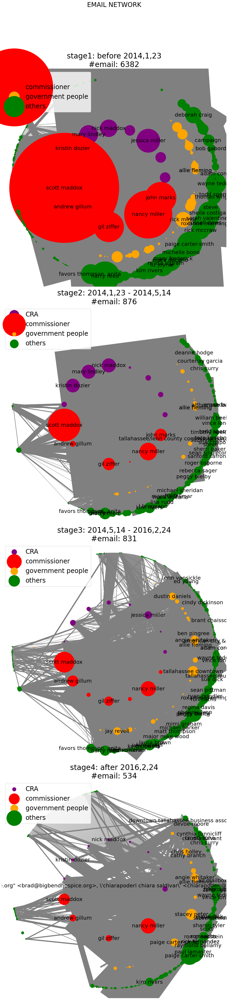

In [58]:
# 
adj_email_mat2 = None

fig = plt.figure(figsize=(12,50))
fig.suptitle('EMAIL NETWORK',fontsize = 24, y=1.04)
start_time = time.time()
# fig.text(.5, 1.005, 'edge thickness: #emails weighted by #receivers, then normalized $\in$(0,1)\n node size: #emails related', fontsize = 20, ha='center')
for k in trange(4):
    # build adjmat
    df_temp = df_related_emails.iloc[idxes[k]]
    num_email = len(df_temp)
#     adj_email_mat1 = np.zeros((len(unique_people),len(unique_people)))
    adj_email_mat2 = np.zeros((len(unique_people),len(unique_people)))

    from_list = df_temp['From'].values.tolist()
    to_list = df_temp['To'].values.tolist()
    cc_list = df_temp['CC'].values.tolist()
    num_TO_CC = df_temp['num_TO_CC'].values.tolist()

    for i in range(len(from_list)):
        s = name2id[from_list[i]] # id of the sender
        
        rs = to_list[i]
        for j in range(len(rs)):
            if rs[j] != ('', '', '') and rs[j] != ['', '', '']:
                r = name2id[rs[j]]  # id of the receiver
#                 adj_email_mat1[s,r] += 1
                adj_email_mat2[s,r] += 1/num_TO_CC[i]
        cs = cc_list[i]
        for j in range(len(cs)):
            if cs[j] != ('', '', '') and cs[j] != ['', '', '']:
                r = name2id[cs[j]]  # id of the receiver
#                 adj_email_mat1[s,r] += 1
                adj_email_mat2[s,r] += 1/num_TO_CC[i]
    print('t1', time.time()-start_time)
    
#     adj_email_mat1 = adj_email_mat1 + adj_email_mat1.T
    adj_email_mat2 = adj_email_mat2 + adj_email_mat2.T
    
#     adj_email_mat1 = np.triu(adj_email_mat1, 1)
    adj_email_mat2 = np.triu(adj_email_mat2, 1)
        
#     adj_email_mat2 = adj_email_mat2/adj_email_mat2.max()
    adj_email_mat2 = adj_email_mat2/normalizing_factors[k]
    
    
    
    print('matrix done, time:', time.time()-start_time)
    
    unique_people_combined = unique_people.copy()
    size1 = adj_email_mat2.shape[0]
    size2 = size1 + len(idx_mapping)
    idx_to_remove = []
    for _,v in idx_mapping.items():
        new_r = np.zeros(size1)
        for r_idx in v:
            new_r += adj_email_mat2[r_idx,:]
            idx_to_remove.append(r_idx)
        adj_email_mat2 = np.vstack((adj_email_mat2,new_r))

    for _,v in idx_mapping.items():
        new_c = np.zeros(size2)
        for c_idx in v:
            new_c += adj_email_mat2[:,c_idx]
        adj_email_mat2 = np.hstack((adj_email_mat2,new_c.reshape(-1,1)))
    
    adj_email_mat2 = np.delete(adj_email_mat2, idx_to_remove, axis=0)
    adj_email_mat2 = np.delete(adj_email_mat2, idx_to_remove, axis=1)
    
    unique_people_combined = np.array(unique_people_combined)
    unique_people_combined = np.delete(unique_people_combined, idx_to_remove, axis=0)
    unique_people_combined = unique_people_combined.tolist()
    unique_people_combined = standardize_triplet(unique_people_combined)
    unique_people_combined += nodes_to_add
    
#     adj_email_mat2, unique_people_combined = combine_nodes(adj_email_mat2, idx_mapping, unique_people, nodes_to_add)
    
    print('nodes combined, time:', time.time()-start_time)
    
    government_idx_list_new = []
    for i,people in enumerate(unique_people_combined):
        for j,people2 in enumerate(gorvenment_people_list):
            if people[2] == people2[2] or (people[0] == people2[0] and people[1] == people2[1]):
                if i not in cra_idx_list_new and i not in commissioner_idx_list_new :
                    government_idx_list_new.append(i)
                    break
    print('government_idx_list updated, time:', time.time()-start_time)
    
    government_idx_list_new2 = government_idx_list_new.copy()
    total_idx_list_new2 = total_idx_list_new.copy()
    new_idx = np.linspace(0,len(unique_people_combined),len(total_idx_list_new)+1, dtype = int)[:-1]
    for i in range(len(total_idx_list_new2)):
        p1_idx = total_idx_list_new2[i]
        p1 = unique_people_combined[p1_idx]
        p2_idx = new_idx[i]
        p2 = unique_people_combined[p2_idx]
        unique_people_combined[p1_idx], unique_people_combined[p2_idx] = p2, p1
        adj_email_mat2[:,[p1_idx, p2_idx]] = adj_email_mat2[:,[p2_idx, p1_idx]]
        adj_email_mat2[[p1_idx, p2_idx],:] = adj_email_mat2[[p2_idx, p1_idx],:]
        
        if p2_idx in government_idx_list_new2:
            total_idx_list_new2[i], government_idx_list_new2[government_idx_list_new.index(p2_idx)] = p2_idx, p1_idx
        else:
            total_idx_list_new2[i] = p2_idx

#     name2id, id2name = nameToIndexDict(unique_people)

    cra_idx_list_new2 = total_idx_list_new2[:len(cra_idx_list_new)]
    commissioner_idx_list_new2 = total_idx_list_new2[len(cra_idx_list_new):]
#     adj_email_mat2, unique_people_combined2, total_idx_list_new2, cra_idx_list_new2, commissioner_idx_list_new2, government_idx_list_new2 = switch_index(adj_email_mat2, unique_people_combined, total_idx_list_new, cra_idx_list_new, commissioner_idx_list_new, government_idx_list_new)
    name2id_new2, id2name_new2 = nameToIndexDict(unique_people_combined)
    
    print('nodes switched, time:', time.time()-start_time)
    
    plt.subplot(4,1,k+1)
#     nodes = unique_people_combined

    G = nx.Graph()
#     G.add_nodes_from(nodes)
    networks = [1,2,3,4]

    networks_list = []
    for i in range(len(unique_people_combined)):
        if i in cra_idx_list_new2:
            networks_list.append(1)
        elif i in commissioner_idx_list_new2:
            networks_list.append(2)
        elif i in government_idx_list_new2:
            networks_list.append(3)
        else:
            networks_list.append(4)
    print('seperated people by position, time:', time.time()-start_time)
        
    # map color
    node_network_map = dict(zip(unique_people_combined, networks_list))
    colors = ['purple', 'red', 'orange', 'green']
    color_map = dict(zip(networks, colors))

    # build graph from numpy array 
    G = nx.from_numpy_array(adj_email_mat2, create_using=nx.Graph)
    G = nx.relabel_nodes(G, id2name_new2)   # relabel the node with corresponding names

    nodes_by_color = {val: [node for node in G if color_map[node_network_map[node]] == val]
                      for val in colors}
    print('Done adding edges and nodes:', time.time()-start_time)
    
    pos = nx.circular_layout(G) # calculate position
    radii = [5,8,10]  # set the diameter for the three circles

    for ea in pos.keys():
        new_r = 1
        if ea in nodes_by_color['red']:
            new_r = radii[0]
        elif ea in nodes_by_color['purple']:
            new_r = radii[0]
        elif ea in nodes_by_color['orange']:
            new_r = radii[1]
        elif ea in nodes_by_color['green']:
            new_r = radii[2]
        else:
            pass
        pos[ea] *= new_r   # reposition nodes as concentric circles
    
    # calculate edge width
    edge_width = []
    edges_list = G.edges()
    for s,t in edges_list:
        edge_width.append(adj_email_mat2[name2id_new2[s],name2id_new2[t]])
    edge_width = np.array(edge_width)
    edge_width = 20*edge_width
    
    # calculate node size
    node_size = adj_email_mat2.sum(axis=0)
    node_size = 100*node_size
    
    # select several most active people and label their names
    labeling_idx = node_size.argsort()[-25:][::-1].tolist()
    
    # select several strongest communication and label their nodes
    labeling_edge_idx = edge_width.argsort()[-25:][::-1]
    for i in labeling_edge_idx:
        labeling_idx.append(name2id_new2[list(G.edges())[i][0]])
        labeling_idx.append(name2id_new2[list(G.edges())[i][1]])
        
    labeling_idx = list(set(labeling_idx)) 
    labels = {}
    for i in labeling_idx:
        node = id2name_new2[i]
        labels[node] = node[0] + ' ' + node[1]
        
    # label the name from cra and commissioner group
#     for node,group in node_network_map.items():
#         if group == 1 or group == 2:
#             labels[node] = node[0] + ' ' + node[1]

    node_sizes = {}
    node_sizes['red'] = node_size[commissioner_idx_list_new2]
    node_sizes['purple'] = node_size[cra_idx_list_new2]
    node_sizes['orange'] = node_size[government_idx_list_new2]
    node_sizes['green'] = node_size[[item for item in np.arange(len(unique_people_combined)) if item not in (total_idx_list_new2+government_idx_list_new2)]]

    
    legend_labels = {'red': 'commissioner', 'purple':'CRA','orange': 'government people','green': 'others' }
    for color, node_names in nodes_by_color.items():
        nx.draw_networkx_nodes(G, pos=pos, node_size=node_sizes[color], nodelist=node_names, node_color=color, label=legend_labels[color])

    nx.draw_networkx_edges(G, pos=pos, width=edge_width, edge_color = 'grey')
    nx.draw_networkx_labels(G, pos=pos, labels=labels, font_size=20, font_color='black')
    plt.title('stage'+str(k+1)+': '+stage_labels[k] + '\n#email: '+str(num_email),fontsize = 28)
    plt.legend(fontsize = 24, loc=2)
    plt.axis('off')
    print('Done plotting:', time.time()-start_time)
    
    # release memory, especially adj_email_mat2, otherwise it will crash
    adj_email_mat2 = None
#     unique_people_combined = None
#     unique_people_combined2 = None
#     adj_mat = None

plt.tight_layout()
plt.show()


# centrality

run section 2, 3 and some of 11

## directed

min 0.0
mean 1008.2960151304211
max 4127749.6873849095


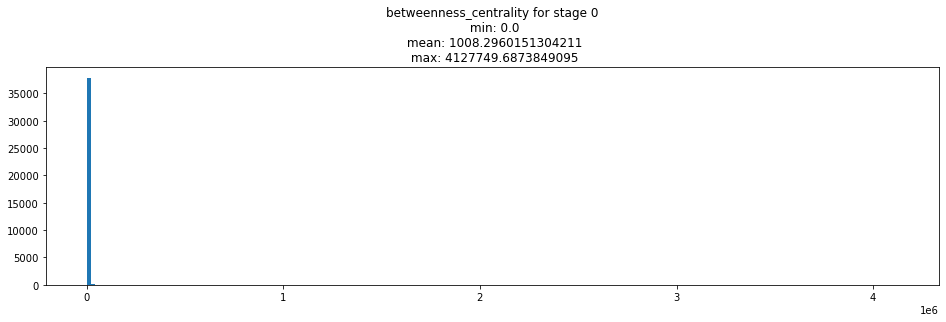

min 0.0
mean 42.52155296960782
max 204081.7092428513


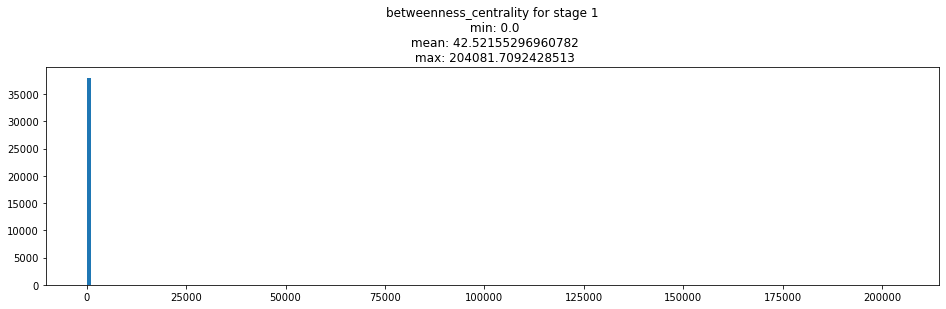

min 0.0
mean 358.27492185242585
max 1080397.9757444682


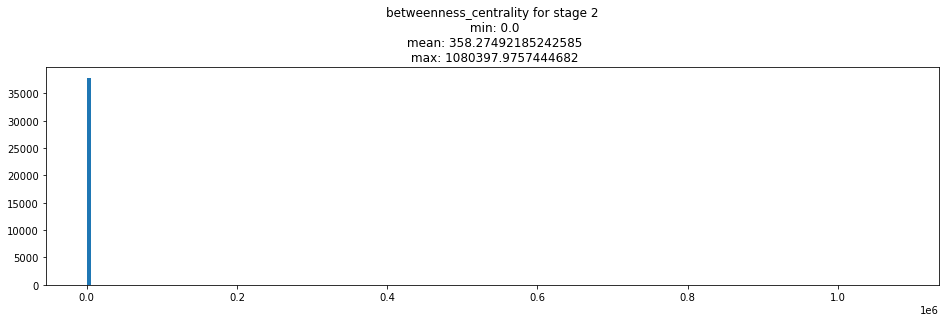

min 0.0
mean 243.9425516824713
max 1267251.7462590612


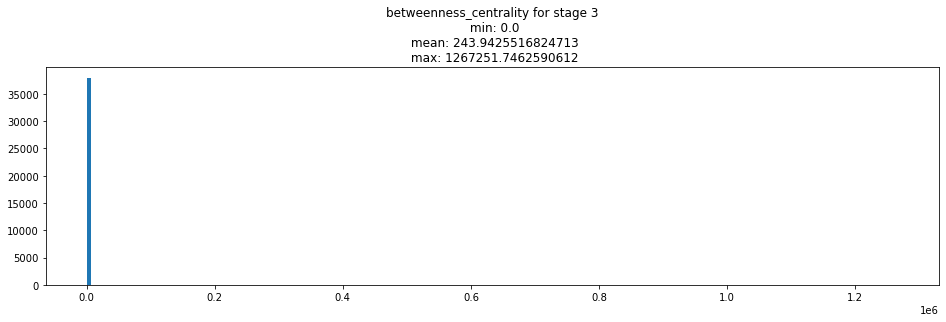

In [21]:
# 
adj_email_mat2 = None

start_time = time.time()
for k in trange(4):
    # build adjmat
    df_temp = df_email.iloc[idxes[k]]
    num_email = len(df_temp)
#     adj_email_mat1 = np.zeros((len(unique_people),len(unique_people)))
    adj_email_mat2 = np.zeros((len(unique_people),len(unique_people)))

    from_list = df_temp['From'].values.tolist()
    to_list = df_temp['To'].values.tolist()
    cc_list = df_temp['CC'].values.tolist()
    num_TO_CC = df_temp['num_TO_CC'].values.tolist()

    for i in range(len(from_list)):
        s = name2id[from_list[i]] # id of the sender
        
        rs = to_list[i]
        for j in range(len(rs)):
            if rs[j] != ('', '', '') and rs[j] != ['', '', '']:
                r = name2id[rs[j]]  # id of the receiver
#                 adj_email_mat1[s,r] += 1
                adj_email_mat2[s,r] += 1/num_TO_CC[i]
        cs = cc_list[i]
        for j in range(len(cs)):
            if cs[j] != ('', '', '') and cs[j] != ['', '', '']:
                r = name2id[cs[j]]  # id of the receiver
#                 adj_email_mat1[s,r] += 1
                adj_email_mat2[s,r] += 1/num_TO_CC[i]
#     print('t1', time.time()-start_time)
    
#     adj_email_mat1 = adj_email_mat1 + adj_email_mat1.T
#     adj_email_mat2 = adj_email_mat2 + adj_email_mat2.T
    
# #     adj_email_mat1 = np.triu(adj_email_mat1, 1)
#     adj_email_mat2 = np.triu(adj_email_mat2, 1)
        
    adj_email_mat2 = adj_email_mat2/adj_email_mat2.max() # 
    
    G = nx.DiGraph()
    # build graph from numadj_email_mat2py array 
    G = nx.from_numpy_array(adj_email_mat2, create_using=nx.DiGraph)
#     G = nx.relabel_nodes(G, id2name_new2)   # relabel the node with corresponding names
    
#     fig = plt.figure(figsize=(16,4))
#     fig.suptitle('centrality for stage '+ str(k),fontsize = 24, y=1.04)
    
#     dc = (len(G.nodes())-1)*np.array(list(nx.centrality.in_degree_centrality(G).values()))
#     plt.subplot(1,4,1)
#     plt.hist(dc, bins = 200)
#     plt.title('in_degree_centrality\n min: {}\n mean: {}\n max: {}'.format(dc.min(), dc.mean(), dc.max()))
#     print('min', dc.min())
#     print('mean', dc.mean())
#     print('max', dc.max())
#     dc = (len(G.nodes())-1)*np.array(list(nx.centrality.out_degree_centrality(G).values()))
#     plt.subplot(1,4,2)
#     plt.hist(dc, bins = 200)
#     plt.title('out_degree_centrality\n min: {}\n mean: {}\n max: {}'.format(dc.min(), dc.mean(), dc.max()))
#     print('min', dc.min())
#     print('mean', dc.mean())
#     print('max', dc.max())
#     dc = (len(G.nodes())-1)*np.array(list(nx.centrality.degree_centrality(G).values()))
#     plt.subplot(1,4,3)
#     plt.hist(dc, bins = 200)
#     plt.title('degree_centrality\n min: {}\n mean: {}\n max: {}'.format(dc.min(), dc.mean(), dc.max()))
#     print('min', dc.min())
#     print('mean', dc.mean())
#     print('max', dc.max())
#     cc = np.array(list(nx.closeness_centrality(G).values()))
#     print('min', cc.min())
#     print('mean', cc.mean())
#     print('max', cc.max())
#     plt.subplot(1,4,4)
#     plt.hist(cc, bins = 200)
#     plt.title('closeness_centrality\n min: {}\n mean: {}\n max: {}'.format(cc.min(), cc.mean(), cc.max()))
#     plt.tight_layout()
    
    plt.figure(figsize=(16,4))
    bc = np.array(list(nx.betweenness_centrality(G,normalized=False).values()))
    print('min', bc.min())
    print('mean', bc.mean())
    print('max', bc.max())
    plt.hist(bc, bins = 200)
    plt.title('betweenness_centrality for stage '+ str(k)+'\n min: {}\n mean: {}\n max: {}'.format(bc.min(), bc.mean(), bc.max()))
    
    
    plt.show()
    
    adj_email_mat2 = None
    
#     unique_people_combined = None
#     unique_people_combined2 = None
#     adj_mat = None


# plt.show()


min 0.0
mean 1.853161364890068
max 981.0000000000001


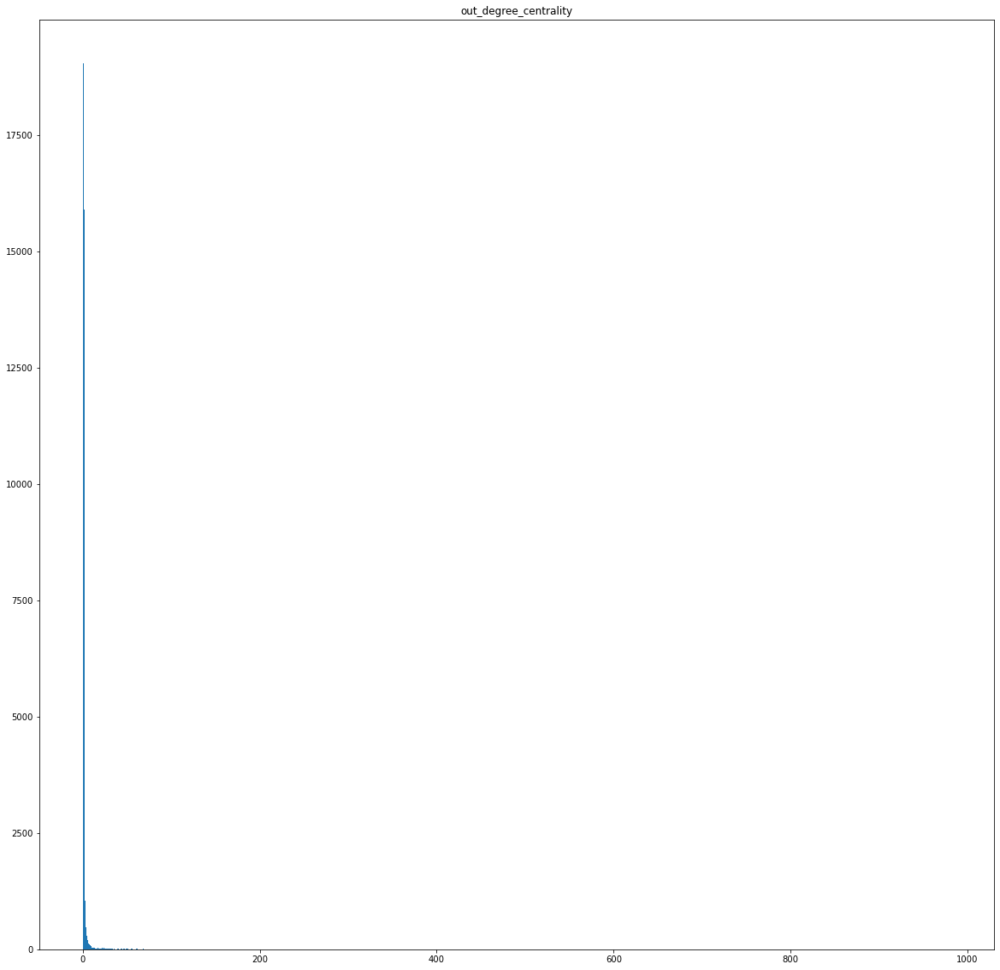

In [71]:
dc = (adj_email_mat2.shape[0]-1)*np.array(list(nx.centrality.degree_centrality(G).values()))
print('min', dc.min())
print('mean', dc.mean())
print('max', dc.max())
plt.hist(dc, bins = 1000)
plt.title('out_degree_centrality')
plt.show()